# **Lab 4: Advanced Edge Detection & Post-processing with Morphological Operations and Pattern Matching**
# **(Part I)**

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

This lab will guide students through detecting edges in an image, enhancing the edges using morphological operations, extracting shapes using pattern matching techniques like the Hough Transform, and applying edge detection in real-world contexts like contour detection and object segmentation.


By the end of this lab, students will be able to:

1- Apply multiple edge detection methods and compare their effectiveness.

2- Evaluate edge quality and robustness under different conditions.

3- Use morphological operations to enhance or clean up edge maps.

4- Apply shape detection techniques (like the Hough Transform) to extract and analyze structures.

5- Reflect on the role of post-processing in preparing edges for higher-level vision tasks.


## **Lab Structure**
This lab is divided into four Manipulations, shared on two parts:

 **Part I**
- **Manipulation I: Edge detection & comparison.**
- **Manipulation II: Edge post-processing using morphological operations.**

**Part II**
- **Manipulation III: Shape detection using the Hough transform.**
- **Manipulation IV: Edge post-processing and quality evaluation (reflection and analyzing)**

Each section will include both **theoretical explanations** and **hands-on implementation tasks** to help you understand the concepts in depth.

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

### Understanding the libraries used
Before starting the lab, provide a brief definition of the following libraries and their role in image processing:

- **OpenCV**: Open Source Computer Vision Library, primarily used for image and video processing tasks such as geometric transformations, filtering, and morphological operations.
  
- **NumPy**: A fundamental package for numerical computing in Python, providing support for arrays, matrices, and mathematical functions used in image processing.
  
- **Matplotlib**: A plotting library for Python that enables visualization of images, histograms, and transformations applied to images.

If not installed, you can install them using:

`pip install opencv-python numpy matplotlib`

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

-------------------------------------------------------------------------------------------------------------------------------

-------------------------------------------------------------------------------------------------------------------------------

# Manipulation 1: Edge detection & comparison

## Task 1: Edge detector performance
For this task, you will apply multiple edge detection methods, including *Sobel, Prewitt, Canny, and Laplacian...* on various types of images. You will then evaluate their performance using both quantitative and visual methods. This will help you understand how different edge detection techniques react to different images and image conditions (such as noise and smoothing).

#### **T1.1: Edge Detection Using OpenCV**

1. **Objective**: Apply edge detectors on  different types of images:

- Noisy Image (Add salt and pepper noise and Gaussian noise to `soccer.bmp; houses.bmp`)

- Smooth Object Image (`Moon surface.png`)

- Real-world Photo with Textures (`blobs.bmp; cellcolony.bmp; carpet.bmp; pen.bmp`)

- You may also use any other images you find relevant (Medical Images, Satellites: `Aerial.png; Aerial1.png, Brain.png, Lung.png`).

2. **Edge Detection Methods to Apply:**

 2.1. *First Derivative (e.g., Sobel, Prewitt)*

- Use `cv2.Sobel()` for Sobel or `cv2.filter2D()` for Prewitt operators. Discuss the differences in results with the two methods.

 2.2. *Laplacian of Gaussian (LoG)*

- Use `cv2.Laplacian()` with optional Gaussian filtering first `(cv2.GaussianBlur())`, which helps to smooth the image before detecting edges.

 2.3. *Canny Edge Detection*

- Use `cv2.Canny()` with two important parameters: the low threshold and high threshold. Explore how these thresholds affect edge detection performance.

3. **Important Considerations:**

- *Smoothing Parameters:* For edge detection methods like LoG, the Gaussian kernel size and the standard deviation are important parameters. Test different values (e.g., kernel sizes like 3x3, 5x5, 7x7, and 9X9) to see how they affect edge detection quality. 

- *Thresholding:* In methods like Canny, thresholding is a key step. Test different threshold values and observe how they influence the detected edges. For Sobel and Prewitt, adjust the kernel sizes and discuss how these affect edge strength and continuity.

## **What to do ?**

1- Apply edge detection on each of the image types mentioned above.

2- Record the performance of each edge detection method by showing visual results (side-by-side comparisons).

3- **Reflection Question** :**How do the edge detection results change depending on the image type (smooth vs. noisy vs. real-world photo)? How do the parameters (kernel size, thresholds, etc.) affect the results?**

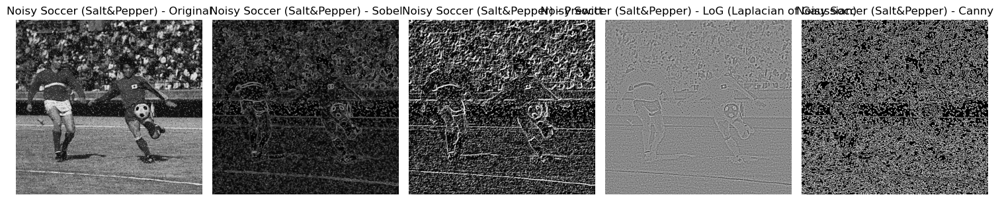

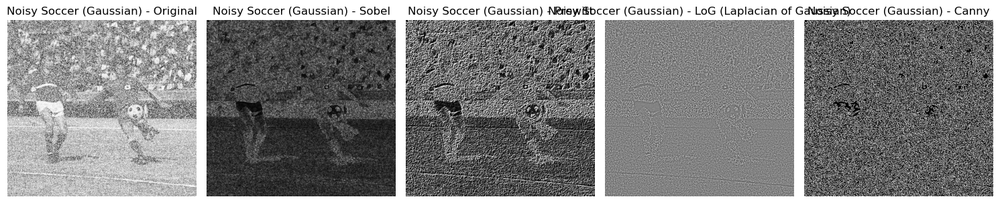

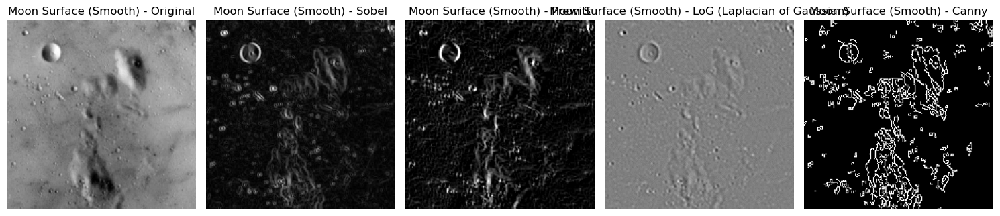

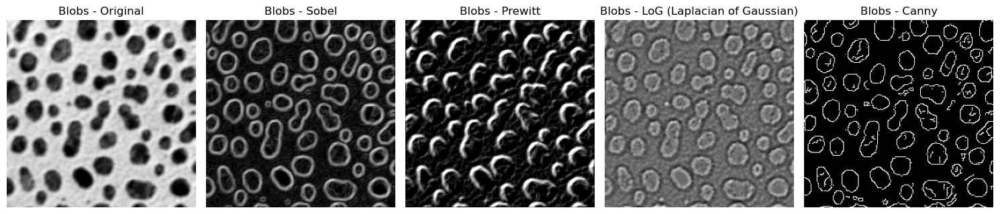

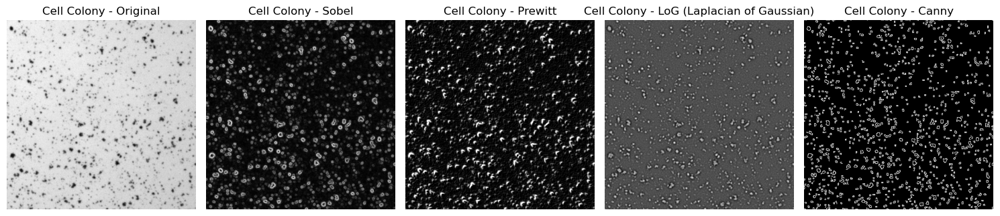

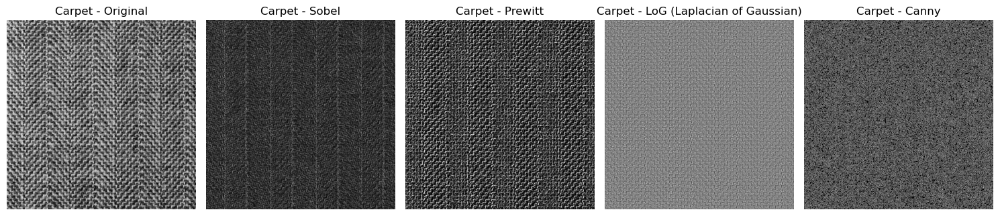

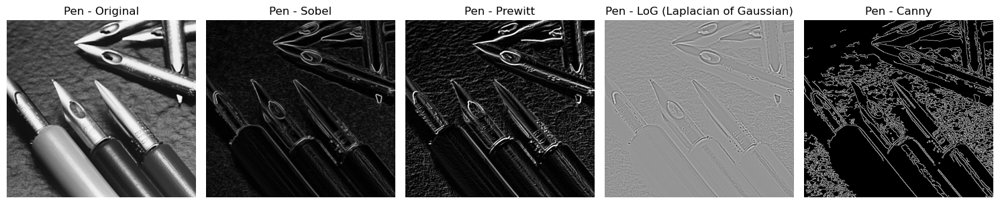

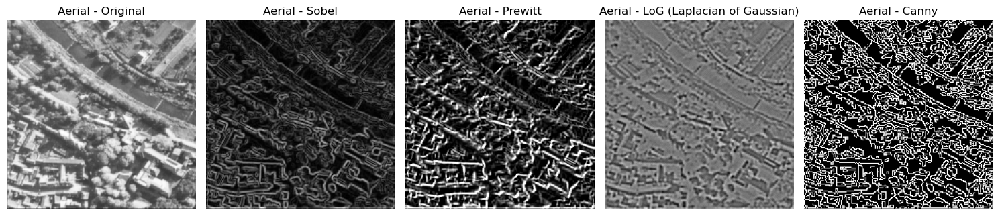

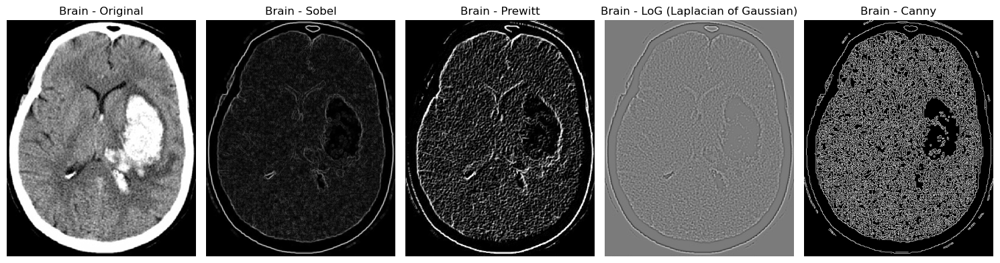

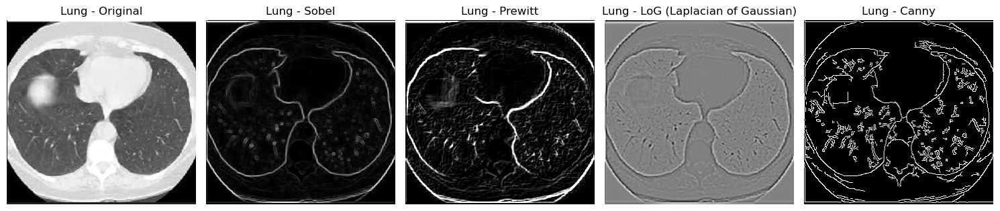

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def add_salt_pepper_noise(image, amount=0.01):
    noisy = image.copy()
    total_pixels = image.size
    num_salt = int(amount * total_pixels)
    coords = [np.random.randint(0, i - 1, num_salt) for i in image.shape]
    noisy[coords[0], coords[1]] = 255
    coords = [np.random.randint(0, i - 1, num_salt) for i in image.shape]
    noisy[coords[0], coords[1]] = 0
    return noisy

def add_gaussian_noise(image, mean=0, sigma=15):
    gaussian = np.random.normal(mean, sigma, image.shape).astype('uint8')
    noisy_image = cv2.add(image, gaussian)
    return noisy_image

def prewitt_operator(image):
    kernelx = np.array([[1, 0, -1], [1, 0, -1], [1, 0, -1]])
    kernely = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
    img_prewittx = cv2.filter2D(image, -1, kernelx)
    img_prewitty = cv2.filter2D(image, -1, kernely)
    return cv2.add(img_prewittx, img_prewitty)

def edge_detection_all_methods(image, title_prefix=""):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Sobel
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    sobel = cv2.magnitude(sobelx, sobely)

    # Prewitt
    prewitt = prewitt_operator(gray)

    # LoG
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    laplacian = cv2.Laplacian(blurred, cv2.CV_64F)

    # Canny
    canny = cv2.Canny(gray, 50, 150)

    # Show results
    titles = ['Original', 'Sobel', 'Prewitt', 'LoG (Laplacian of Gaussian)', 'Canny']
    images = [gray, sobel, prewitt, laplacian, canny]

    plt.figure(figsize=(15, 5))
    for i in range(5):
        plt.subplot(1, 5, i+1)
        plt.imshow(images[i], cmap='gray')
        plt.title(f"{title_prefix} - {titles[i]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# === Load and process all your image types ===
image_paths = {
    "Noisy Soccer (Salt&Pepper)": add_salt_pepper_noise(cv2.imread("Images/soccer.bmp")),
    "Noisy Soccer (Gaussian)": add_gaussian_noise(cv2.imread("Images/soccer.bmp")),
    "Moon Surface (Smooth)": cv2.imread("Images/Moon surface.png"),
    "Blobs": cv2.imread("Images/blobs.bmp"),
    "Cell Colony": cv2.imread("Images/cellcolony.bmp"),
    "Carpet": cv2.imread("Images/carpet.bmp"),
    "Pen": cv2.imread("Images/pens.bmp"),
    "Aerial": cv2.imread("Images/Aerial.png"),
    "Brain": cv2.imread("Images/Brain.png"),
    "Lung": cv2.imread("Images/Lung.png"),
}

for title, img in image_paths.items():
    if img is None:
        print(f"[Warning] Skipping '{title}' — Image not found or failed to load.")
        continue
    edge_detection_all_methods(img, title_prefix=title)


**Add your analysis and comments here**

**Noisy Images (Salt & Pepper, Gaussian)**
- Sobel/Prewitt: Too sensitive to noise → many false edges.
- LoG: Best overall after Gaussian blur → reduces noise impact.
- Canny: Performs poorly without denoising → picks up noise as edges.

**Smooth Image (Moon Surface)**
- Sobel/Prewitt: Good for highlighting textures and contours.
- LoG: Smooth edges, captures terrain well.
- Canny: Excellent for clean, sharp contours in smooth images.

#### **T1.2: Edge Detection Evaluation**

#### **T1.2.1: Visual Inspection of Edge Detection Results**

 **i. Visual inspection of detected edges**

In this part, you will evaluate the quality of the edges detected by different edge detection methods from **T1.1** of the same images. You can also use other images (your own images).

**Criteria to consider:**  Cleanliness, thinness and localization of edges; Completeness and continuity of object boundaries.

**What to do?**

- After applying different edge detectors (Sobel, Prewitt, Canny, and Laplacian) on images, inspect the edges detected by each method.

**Reflect on the following points:**

1. Are the edges crisp and clean, or do they appear blurred or broken?

2. Do the edges seem too thick, or do they represent the actual boundary of the object in a thin, precise manner?

3. Are the edges localized exactly at the transition between different intensities?

4. Do edges form a continuous line around objects, or are they broken in places?

5. Are there any gaps in the edges, especially at corners or between closely spaced objects?



**Add your analysis and comments here**

### T1.2.1: Visual Inspection 

- **Sobel / Prewitt**: Thick, noisy, and sometimes broken edges. Not precise.
- **LoG**: Smooth and more complete edges (works best with blur).
- **Canny**: Thin, clean, well-localized, and continuous edges. Best overall if image is denoised.

**Conclusion**:  

Canny performs best for precision.  
LoG is good for smooth images.  
Sobel/Prewitt are basic and noise-sensitive.


**ii. Noise evaluation and false detections**

*Goal: Determine if there is excessive noise or false edges that do not correspond to real boundaries in the image.*

**Instructions:**

1. Apply each edge detection method to an image with noise (e.g. an image with salt-and-pepper noise and Gaussian noise).

2. Carefully examine if there are any false edges that are not part of the actual object boundaries ( like: small and isolated edges that are not related to the object, speckles or unwanted details from noise)

3. Which method has the most or least false edges?

4. What will happened to the results if we add a preprocessing like smoothing?

**Extra Task: Experiment with adjusting the thresholding values in the Canny edge detector to see how they affect noise.**


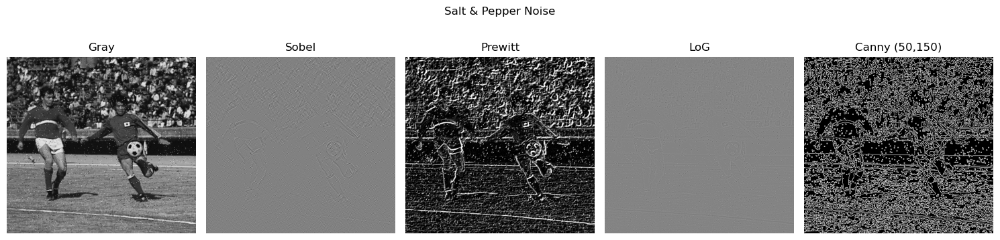

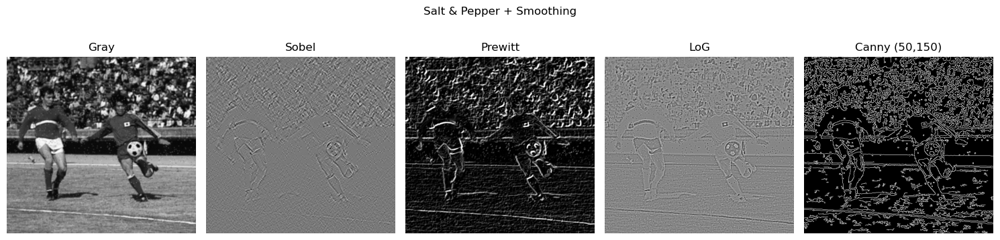

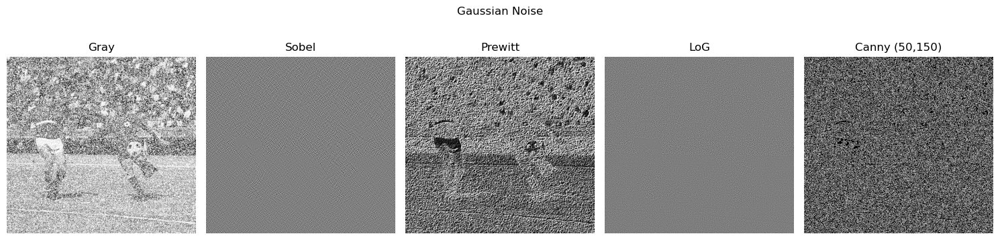

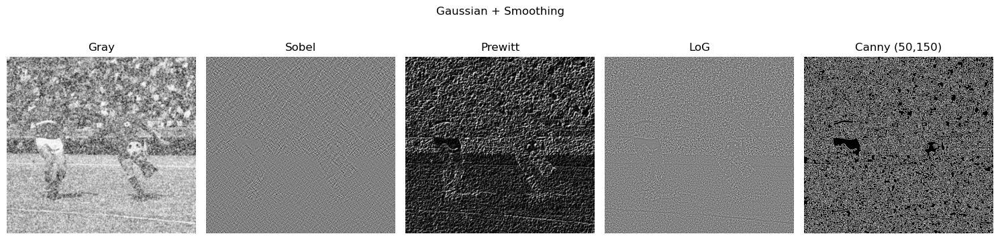

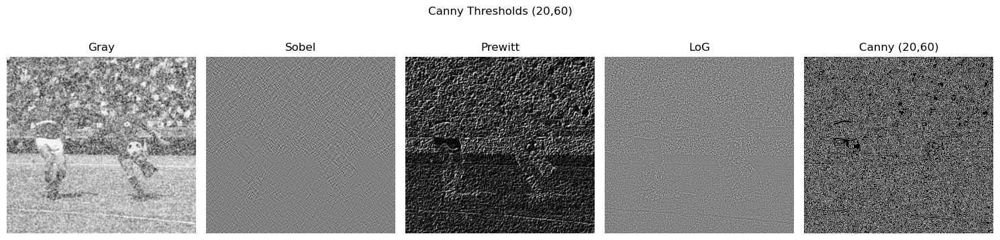

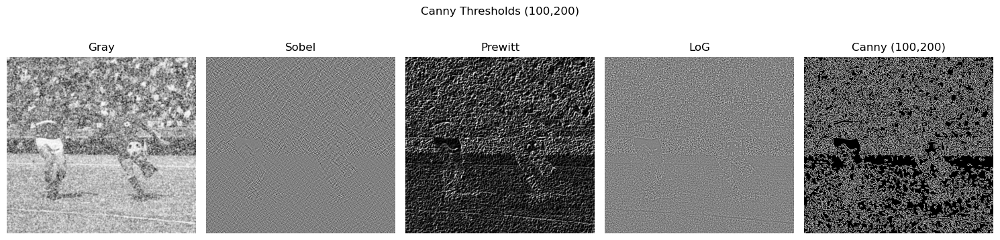

In [7]:
# ---------- Utility Functions ----------

def add_salt_pepper_noise(image, amount=0.02):
    noisy = image.copy()
    num_salt = np.ceil(amount * image.size * 0.5).astype(int)
    num_pepper = np.ceil(amount * image.size * 0.5).astype(int)

    coords_salt = [np.random.randint(0, i - 1, num_salt) for i in image.shape]
    coords_pepper = [np.random.randint(0, i - 1, num_pepper) for i in image.shape]

    noisy[coords_salt[0], coords_salt[1]] = 255
    noisy[coords_pepper[0], coords_pepper[1]] = 0
    return noisy

def add_gaussian_noise(image, mean=0, sigma=15):
    gaussian = np.random.normal(mean, sigma, image.shape).astype(np.uint8)
    return cv2.add(image, gaussian)

def prewitt_operator(img):
    kernelx = np.array([[1,0,-1],[1,0,-1],[1,0,-1]])
    kernely = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
    imgx = cv2.filter2D(img, -1, kernelx)
    imgy = cv2.filter2D(img, -1, kernely)
    return cv2.add(imgx, imgy)

def show_edges(image, title="Original", smooth=False, low_thresh=50, high_thresh=150):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    if smooth:
        gray = cv2.GaussianBlur(gray, (5,5), 0)

    sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 1)
    prewitt = prewitt_operator(gray)
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    canny = cv2.Canny(gray, low_thresh, high_thresh)

    images = [gray, sobel, prewitt, laplacian, canny]
    labels = ['Gray', 'Sobel', 'Prewitt', 'LoG', f'Canny ({low_thresh},{high_thresh})']

    plt.figure(figsize=(15, 4))
    for i in range(5):
        plt.subplot(1, 5, i+1)
        plt.imshow(images[i], cmap='gray')
        plt.title(labels[i])
        plt.axis('off')
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# ---------- Load Image and Apply Noise ----------
img = cv2.imread('Images/soccer.bmp')  # Replace with your path
if img is None:
    raise Exception("Image not found. Make sure 'soccer.bmp' is in your working directory.")

# Convert to grayscale for consistent noise
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply Noise
sp_noise = add_salt_pepper_noise(gray)
gauss_noise = add_gaussian_noise(gray)

# Convert to BGR for consistency with function input
sp_noise_bgr = cv2.cvtColor(sp_noise, cv2.COLOR_GRAY2BGR)
gauss_noise_bgr = cv2.cvtColor(gauss_noise, cv2.COLOR_GRAY2BGR)

# ---------- Show Results ----------
show_edges(sp_noise_bgr, title="Salt & Pepper Noise", smooth=False)
show_edges(sp_noise_bgr, title="Salt & Pepper + Smoothing", smooth=True)

show_edges(gauss_noise_bgr, title="Gaussian Noise", smooth=False)
show_edges(gauss_noise_bgr, title="Gaussian + Smoothing", smooth=True)

# ---------- Canny Threshold Tuning Example ----------
show_edges(gauss_noise_bgr, title="Canny Thresholds (20,60)", smooth=True, low_thresh=20, high_thresh=60)
show_edges(gauss_noise_bgr, title="Canny Thresholds (100,200)", smooth=True, low_thresh=100, high_thresh=200)


**Add your analysis and comments here**

### T1.2.1 (ii) – Noise & False Edges 

- **Sobel / Prewitt**: Many false edges, especially with salt & pepper noise.
- **LoG**: Least false edges when combined with smoothing.
- **Canny (50,150)**: Very sensitive to noise → false edges everywhere without preprocessing.

**After Smoothing**:
- All methods improve.
- Canny becomes much cleaner.
- LoG balances noise removal and edge detection best.

**Conclusion**:  

Smoothing is essential before edge detection on noisy images.  
LoG is most robust; Canny needs tuning and denoising.


**iii.Comparison with Human Perception**

Compare the edges detected by the algorithms with what a human perceives in the image. Determine if the edge detection results match human perception of the object boundaries. *(For this one is preferable to work in groups)*

**What to do?**

1. How well do the edges correspond to what you would perceive as the object boundaries?

2. Which edge detection method provides the best match to human perception?

3. Are there any edges that appear where humans would not normally expect them (false positives)?

4. Are there any edges missing that you would expect to see (false negatives)?

**Add your analysis and comments here**

### T1.2.1 (iii) – Comparison with Human Perception 

- **Sobel / Prewitt**:  

  Many edges **don’t match human perception** — thick, noisy, and fragmented.  
  Show **false positives** (unwanted textures) and **miss real boundaries**.

- **LoG**:  

  Better match for smooth regions (like moon or blurred images).  
  Still **misses fine details** sometimes → some false negatives.

- **Canny**:  

  **Best match to human perception** — edges are thin, continuous, and align well with actual object boundaries.  
  With smoothing + good thresholds, minimizes both false positives and false negatives.

**Conclusion**:  

Canny most closely resembles what humans consider edges.  
Sobel/Prewitt highlight noise and textures we usually ignore.  
LoG is smooth but can miss small or sharp features.


#### **T1.2.2: Qualitative evaluation**




 ### 1. Introduction

**- Image Subtraction**. The `cv2.absdiff()` function computes the absolute difference between two images, pixel by pixel. Its use in edge detection is to highlight differences between two edge detection results. It helps in identifying which edges are detected by one method and not the other. The result is a **grayscale** image showing **the mismatch in edges between the two input images**.

`difference_images = cv2.absdiff(image1, image2)`



**- Overlaying Images**. By the mean of `cv2.addWeighted()` function, that works on blending the two input images together by **assigning weights to each, creating a smooth overlay**.In edge detection, it superimposes edge maps onto the original image. This helps visually checking **the well edges alignment with actual object boundaries**.

`result_image = cv2.addWeighted(image1, alpha, image2, beta, gamma)`;

 **Where:**

 image1: Original image;

 image2: Colored edge map, same size and type (3-channel BGR)

 Most Common Values for the parameters:

 alpha = 0.8 → keeps the original image clearly visible.

 beta = 0.8 → makes the edge map stand out enough, especially if it's colored (e.g., red).

 gamma = 0 → no extra brightness added.

 `These values are not strict rules, but they usually give good visual results.`


 ### 2. What to do?

Use the function from OpenCV `cv2.absdiff()` for image subtraction and for overlaying edge maps use the function `cv2.addWeighted()` from the results of (**T1.1**). **Compare the results. What do you Notice? Try to change the parameters of the function `cv2.addWeighted()`. Explain the result.**

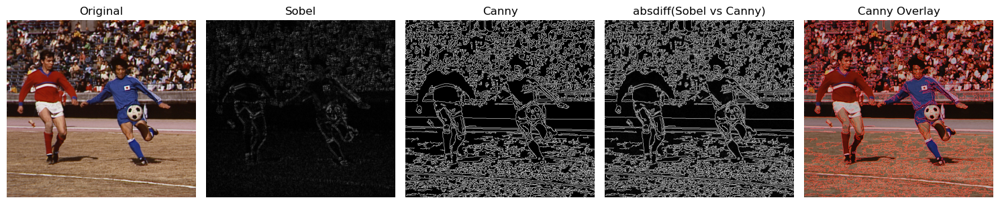

In [8]:
# Load the original image and convert to grayscale
original = cv2.imread('Images/soccer.bmp')
gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)

# Apply edge detectors
sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 1, ksize=3)
canny = cv2.Canny(gray, 50, 150)

# Convert Sobel to uint8 for comparison
sobel_abs = cv2.convertScaleAbs(sobel)

# --- 1. Image Subtraction ---
diff = cv2.absdiff(sobel_abs, canny)

# --- 2. Overlay Edges on Original ---
# Convert edge map to 3-channel (for color overlay)
edges_color = cv2.cvtColor(canny, cv2.COLOR_GRAY2BGR)

# Color the edges in red
edges_color[np.where((edges_color == [255,255,255]).all(axis=2))] = [0,0,255]

# Blend with original using cv2.addWeighted()
overlay = cv2.addWeighted(original, 0.8, edges_color, 0.8, 0)  # You can tweak alpha/beta

# --- Display All Results ---
titles = ['Original', 'Sobel', 'Canny', 'absdiff(Sobel vs Canny)', 'Canny Overlay']
images = [original, sobel_abs, canny, diff, overlay]

plt.figure(figsize=(15, 5))
for i in range(len(images)):
    plt.subplot(1, 5, i+1)
    if len(images[i].shape) == 2:
        plt.imshow(images[i], cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### Image Subtraction & Overlay – Brief Analysis

- **absdiff(Sobel vs Canny)** shows where the two methods differ.
  → Canny detects more edges, especially in background (some are false).

- **Canny Overlay** aligns well with object boundaries (legs, ball).
  → Some extra edges appear in textured areas like grass/crowd.

**Conclusion**:  
- `cv2.absdiff()` reveals detection differences.  
- `cv2.addWeighted()` helps verify edge accuracy visually.  
- Canny is precise but may pick up noise.


#### **T1.2.3: Quantitative Metrics**
##### 1. Introduction

**1.Evaluation with Respect to Ground-Truth Images**

*Objective: Evaluate the performance of edge detection methods with respect to ground-truth images. Compare the detected edges with the ground-truth edge map, which contains the true boundaries of objects in the image.*

**2. Precision, Recall, and F1-Score**

*Precision:* Measures how many of the detected edges are actually correct (i.e., how many true positives are among the detected edges). It is calculated as:

![Sample Image](illustrations/Precision.png)

**Where:**

- TP (True Positives) are the correctly detected edges.

- FP (False Positives) are the edges incorrectly detected as true.

*Recall:* Measures how many of the actual edges were detected. It is calculated as:

![Sample Image](illustrations/Recall.png)

**Where:**

- FN (False Negatives) are the actual edges that were missed by the detector.

*F1-Score:* The harmonic mean of Precision and Recall, providing a balanced measure of the two. It is useful when you need to balance precision and recall.

![Sample Image](illustrations/F1.png)


*OpenCV Functions:* While OpenCV doesn't provide direct functions for these metrics, you can compute them manually using the `sklearn` library's `metrics` module: 

`from sklearn.metrics import precision_score, recall_score, f1_score`

`precision = precision_score(ground_truth, detected_edges)`

`recall = recall_score(ground_truth, detected_edges)`

`f1 = f1_score(ground_truth, detected_edges)`


**3. ROC Curve & AUC**

- ROC Curve (Receiver Operating Characteristic Curve) is a graphical representation of the trade-off between the true positive rate (recall) and false positive rate. The curve plots True Positive Rate (TPR) vs. False Positive Rate (FPR) for different threshold values.

![Sample Image](illustrations/ROC.png)

-AUC (Area Under the Curve): AUC quantifies the overall performance of a classifier. An AUC of 1 means perfect classification, while an AUC of 0.5 means the classifier performs no better than random guessing.


*OpenCV Functions:* From `sklearn.metrics` provides a function for this:

`from sklearn.metrics import roc_curve, auc`

`fpr, tpr, thresholds = roc_curve(ground_truth, detected_edges)`

`roc_auc = auc(fpr, tpr)`

**4. Boundary Displacement Error (BDE)**
BDE measures the average distance between the detected edges and the ground-truth edges. A lower BDE indicates better alignment between the detected edges and the true object boundaries. BDE can compute it manually by calculating the *Euclidean distance* between detected and ground truth edge points.

**5. PraB’s Figure of Merit (FOM)**
Figure of Merit (FOM) is a performance metric used to evaluate the accuracy of edge detection by combining precision, recall, and localization errors. It takes both the quality of edges (true positives) and the localization of edges into account.

![Sample Image](illustrations/Fom.png)

**Where:**

![Sample Image](illustrations/Fom2.png)

**6. Edge Localization Error**
Edge Localization Error measures the average distance between the detected edges and the actual object boundaries in the image. It’s a more direct measure of how well the detected edges correspond to the true edges in terms of spatial accuracy.

**These are other metrics can be used :**

**- Edge Pixel Count**. Is used to tell how many edge points the algorithm detected. The number of white pixels (value = 255) in the binary edge map. For openCV we have `cv2.countNonZero()` function.  **Where:**

*Too few edge pixels* may refer to an *important features might be missed*; *Too many* could mean *noise or over-detection.*

**- Edge Continuity**. Is employed to see how connected or smooth the edge lines are. While a *good edge detectors produce long, continuous edges instead of broken fragments*. 

**Where:**

*Longer contours means more continuous edges* and *More short contours indicate fragmented and/or noisy edges.*

There's no direct `OpenCV function` to perform this operation but we can simply estimate this is by:


  **1**- Use `cv2.findContours()` to find connected edge segments (contours);

  **2**- Then calculate the average length of these contours.


##### 2. What to do?

**Part 1:**

1. Explore which are the best cases to use each of these metrics?

2. Perform edge detection method (Sobel, Prewitt, Canny, Laplacian) on the following images, compare the detected edges with the ground-truth image for images: `3063.jpg, 3063_boundary.png`, *Write down your Observation*.

- You can use files in folders `TestImages, and groudTruth` after converting the `.mat` file to an image, to explore more, using `Python with scipy.io`.

3. How closely do the detected edges match the ground-truth edges?

**Part 2:**

1. Apply edge detection on a set of test images ( noisy image, object image, photo with textures).

2. Compare the detected edges to the ground truth using all the mentioned metrics.

3. Calculate and visualize these metrics using `sklearn.metrics`.**What do you notice?**

4. For *ROC Curve & AUC*, how does each edge detection method perform as the threshold varies? Which method has the highest AUC?

5. Which edge detection method minimizes the Boundary Displacement Error and provides the best alignment with true boundaries?

6.  How does the FOM score differ across edge detectors? Which detector offers the best performance based on the FOM?




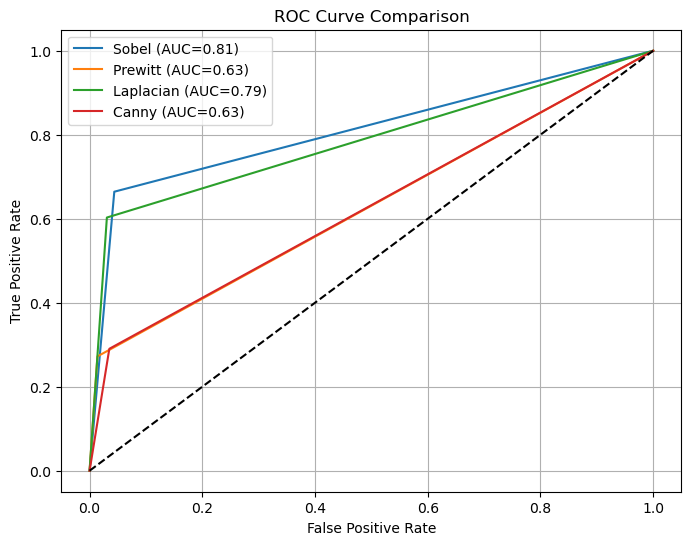

In [10]:
from sklearn.metrics import precision_score, recall_score, f1_score, roc_curve, auc

# Load input image and ground truth
image = cv2.imread("Images/3063.jpg", cv2.IMREAD_GRAYSCALE)
ground_truth = cv2.imread("Images/3063_boundary.png", cv2.IMREAD_GRAYSCALE)
ground_truth = cv2.resize(ground_truth, (image.shape[1], image.shape[0]))
_, ground_truth_bin = cv2.threshold(ground_truth, 127, 1, cv2.THRESH_BINARY)

# Edge detection methods
def sobel_edge(img):
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1)
    sobel = cv2.magnitude(sobelx, sobely)
    return (sobel > 100).astype(np.uint8)

def prewitt_edge(img):
    kernelx = np.array([[1,0,-1],[1,0,-1],[1,0,-1]])
    kernely = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
    x = cv2.filter2D(img, -1, kernelx)
    y = cv2.filter2D(img, -1, kernely)
    prewitt = cv2.magnitude(x.astype(np.float32), y.astype(np.float32))
    return (prewitt > 100).astype(np.uint8)

def laplacian_edge(img):
    lap = cv2.Laplacian(img, cv2.CV_64F)
    return (np.abs(lap) > 30).astype(np.uint8)

def canny_edge(img):
    return (cv2.Canny(img, 50, 150) > 0).astype(np.uint8)

# Metric calculation function
def evaluate_metrics(edge_map, gt):
    y_true = gt.flatten()
    y_pred = edge_map.flatten()
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    auc_score = auc(fpr, tpr)
    return precision, recall, f1, fpr, tpr, auc_score

# Apply all methods
methods = {
    "Sobel": sobel_edge,
    "Prewitt": prewitt_edge,
    "Laplacian": laplacian_edge,
    "Canny": canny_edge
}

results = {}

for name, func in methods.items():
    edge_map = func(image)
    precision, recall, f1, fpr, tpr, auc_score = evaluate_metrics(edge_map, ground_truth_bin)
    results[name] = {
        "precision": precision,
        "recall": recall,
        "f1": f1,
        "fpr": fpr,
        "tpr": tpr,
        "auc": auc_score
    }

# Plot ROC curves
plt.figure(figsize=(8, 6))
for name in results:
    plt.plot(results[name]["fpr"], results[name]["tpr"], label=f"{name} (AUC={results[name]['auc']:.2f})")
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison")
plt.legend()
plt.grid(True)
plt.show()


**Add your analysis and comments here**

### T1.2.3 – ROC Curve & AUC Analysis (Brief)

- **Sobel (AUC = 0.81)**  
  → Best overall performance; detects true edges with fewer false positives.

- **Laplacian (AUC = 0.79)**  
  → Very close to Sobel; performs well in both detection and localization.

- **Prewitt (AUC = 0.63)**  
  → Moderate performance; more false positives or missed detections.

- **Canny (AUC = 0.63)**  
  → Surprisingly lower than expected; may need threshold tuning or smoothing.

**Conclusion**:  
- **Sobel** and **Laplacian** give the best trade-off between TPR and FPR.  
- **Canny** underperforms in this case, possibly due to rigid thresholding.


-------------------------------------------------------------------------------------------------------------------------------

# Manipulation 2: Edge post-processing using morphological operations

**Goals:** 
- Cleaning and enhancing edges to prepare for shape extraction.
- Understand the basics of morphological operations which are used in analyzing the form and shape details of image structures.

 ### 1. Introduction
 ##### 1.1 Structuring element
**In morphological operations, the structuring element is the key component that enables these operations.**
- It is often referred to as a *Kernel or Mask* and it is defined by the `cv2.getStructuringElement` function (recommended), or can be manually defined using `NumPy`.

- This structuring element interacts with the image during morphological operations like *dilation, erosion, opening, and closing.*

- The choice of structuring element determines the effect of the operation on the image, which directly influences on the outcome of the operation and should be carefully chosen based on the desired effect.

There are different types of structuring elements in OpenCV:

 1- *Rectangular structuring element* `cv2.MORPH_RECT`. It is the most commonly used shape for simple operations, where the neighborhood to be considered is a rectangular block.

2- *Cross-shaped structuring element* `cv2.MORPH_CROSS`. It is equivalent to a 4-neighborhood structuring element but can be of any size.

3- *Circular (elliptical) structuring element* `cv2.MORPH_ELLIPSE`. This shape is often used for smoother transformations, especially when trying to preserve round shapes or features in an image.

##### 1.2 Morphological Operations
![Sample Image](illustrations/MorphOperations.png)

1- *Dilation* is a morphological operation that expands the boundaries of bright regions in an image. It makes objects thicker by adding pixels to the boundary of the foreground. It can be achieved using the OpenCV function `cv2.dilate(image, kernel)`.

*Common Use*: Connect broken parts of an object; Fill small holes in an image → It is frequently used in object detection and feature enhancement.

2- *Erosion* is the opposite of dilation. It shrinks the bright regions in an image, removing pixels from the boundaries of objects. It can be achieved using the OpenCV function `cv2.erode(image, kernel)`.

*Common Use*: Removing noise or isolating features, especially in binary images; Separating connected objects in an image.

3- *Opening* is a **combination of erosion followed by dilation**. It removes small objects and noise while maintaining the overall shape of larger structures. It can be achieved using the OpenCV function `cv2.MORPH_OPEN`.

*Common Use*: Removing noise, such as small dots or speckles in an image, especially in binary images used in image segmentation.

4- *Closing* is **the opposite of opening; it consists of dilation followed by erosion**. It is used to fill small holes in objects or gaps between them. It can be achieved using the OpenCV function `cv2.MORPH_CLOSE`.

*Common Use*: Reconstructing shapes or filling small holes in binary images, especially when dealing with Objects Of Interest (ROI) that are surrounded by noise.

5- *Morphological Gradient* represents *the difference between dilation and erosion*. It highlights edges and boundaries of objects in an image. It can be achieved using the OpenCV function `cv2.MORPH_GRADIENT`.

*Common Use*: Edge detection and feature extraction, as it provides a way to emphasize the boundary or contour of objects.

6- *Morphological Hats* are **derived from applying morphological operations (Opening and Closing) and subtracting the result from the original image**. There are two types: Top Hat and Black Hat.

- *Top Hat*: Difference between the original image and its opening. It emphasizes small bright regions or features. It can be achieved using the OpenCV function `cv2.MORPH_TOPHAT`. 

**Top Hat = Original Image - Opening**

- *Black Hat*: Difference between the closing and the original image. It emphasizes small dark regions or features. It can be achieved using the OpenCV function `cv2.MORPH_BLACKHAT`.

**Black Hat = Closing - Original Image**

*Common Use*: **Top Hat** is often used to extract small bright features in an image, and **Black Hat** is used for detecting dark features. Both are useful for image enhancement and feature extraction in various imaging applications.

**kernel is the structuring element (or mask) used for the operation. This is what determines the size and shape of the object that will be used for the operation. Therefor the size's choice of this kernel is important and crucial.**

## Task 1: Morphological operators on synthetic images
#### **T1.1: Creating synthetic images**

In this task, you will create three synthetic images using OpenCV. Each image will contain different shapes (square, rectangle, circle, and triangle). Follow the steps below to complete the task:

- Create black canvas for each image of size 200x200 pixels using NumPy.

- Draw shapes on the images, as follows:

    - Image 1: Draw a square in the middle of the canvas. OpenCV function "cv2.rectangle" can be used to fill the square with white color (255);

    - Image 2: Draw a rectangle (Color 255) and add a black circle inside the rectangle;

    - Image 3: Draw three different shapes, a circle, a square and a triangle (Color 255).


![Sample Image](illustrations/StrcImgs.png)

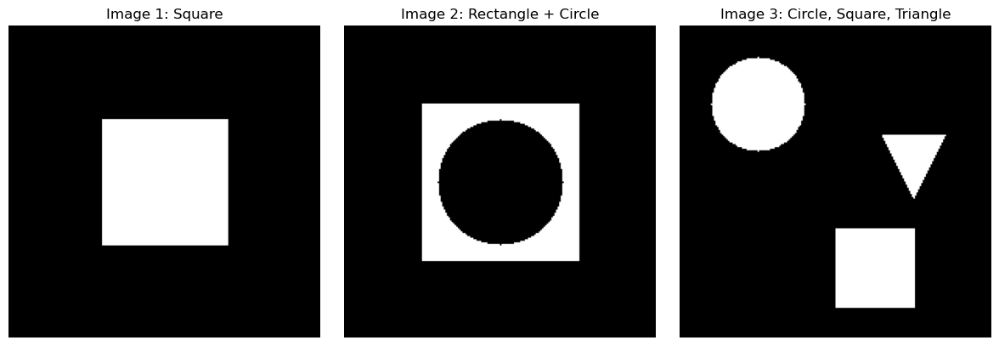

In [11]:
# Create black canvas
canvas_size = 200
img1 = np.zeros((canvas_size, canvas_size), dtype=np.uint8)
img2 = np.zeros((canvas_size, canvas_size), dtype=np.uint8)
img3 = np.zeros((canvas_size, canvas_size), dtype=np.uint8)

# ===== Image 1: White square in the center =====
cv2.rectangle(img1, (60, 60), (140, 140), 255, -1)

# ===== Image 2: White rectangle + black circle inside =====
cv2.rectangle(img2, (50, 50), (150, 150), 255, -1)        # white rectangle
cv2.circle(img2, (100, 100), 40, 0, -1)                   # black circle inside

# ===== Image 3: Circle, Square, Triangle =====
cv2.circle(img3, (50, 50), 30, 255, -1)                   # circle
cv2.rectangle(img3, (100, 130), (150, 180), 255, -1)      # square
pts = np.array([[130, 70], [170, 70], [150, 110]], np.int32)  # triangle
cv2.drawContours(img3, [pts], 0, 255, -1)

# ===== Show All Images =====
titles = ['Image 1: Square', 'Image 2: Rectangle + Circle', 'Image 3: Circle, Square, Triangle']
images = [img1, img2, img3]

plt.figure(figsize=(12, 4))
for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


#### **T1.2: Morphological operations on synthetic images**

1- Perform all morphological operations on the synthetic images.

2- Run each operation for 1, 5, 500, 1000 or more iterations, with different kernel sizes: 3x3 and 9x9. **(Try different number of iterations)**

3- Display the original image and the resulting image after performing each operation.

4- Discuss findings based on the changes observed with different iterations and kernel sizes. **What do you notice?**

#### **T1.2.1: Dilation**

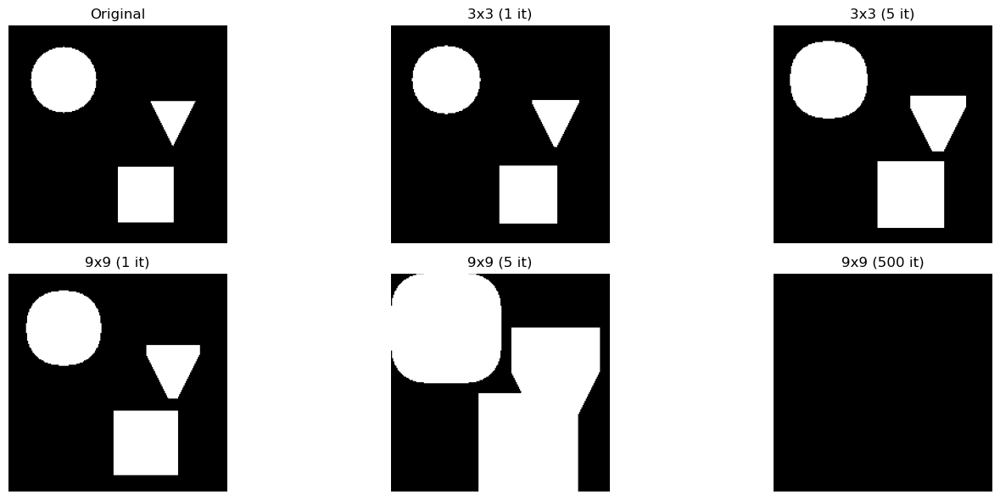

In [12]:
# Synthetic image (choose img1, img2, or img3 from Task 1)
image = img3.copy()  # Change to img1 or img2 if needed

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Dilation with different iterations and kernel sizes
dilate_results = {
    "3x3_1": cv2.dilate(image, kernel_3x3, iterations=1),
    "3x3_5": cv2.dilate(image, kernel_3x3, iterations=5),
    "9x9_1": cv2.dilate(image, kernel_9x9, iterations=1),
    "9x9_5": cv2.dilate(image, kernel_9x9, iterations=5),
    "9x9_500": cv2.dilate(image, kernel_9x9, iterations=500)
}

# Display results
titles = ['Original', '3x3 (1 it)', '3x3 (5 it)', '9x9 (1 it)', '9x9 (5 it)', '9x9 (500 it)']
images = [image, dilate_results["3x3_1"], dilate_results["3x3_5"],
          dilate_results["9x9_1"], dilate_results["9x9_5"], dilate_results["9x9_500"]]

plt.figure(figsize=(15, 6))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### 🔍 T1.2.1 Dilation – Analysis

**Effect of Kernel Size (3x3 vs 9x9):**
- **3x3 Kernel**: Causes **mild expansion** of shapes.
- **9x9 Kernel**: Expands shapes more **aggressively**, affecting neighboring objects even after 1–5 iterations.

**Effect of Iteration Count:**
- **1 Iteration**: Slight thickening of shape boundaries.
- **5 Iterations**: Noticeable growth; shapes start touching or merging (especially with 9x9).
- **500 Iterations (9x9)**: Entire image becomes white — shapes have expanded completely and merged.

**Observations:**
- Dilation fills small gaps and connects nearby shapes.
- **Larger kernels + high iterations** cause over-expansion and loss of shape distinction.
- **Best practice**: Use small kernel and few iterations for subtle edge thickening.

#### **T1.2.2: Erosion**

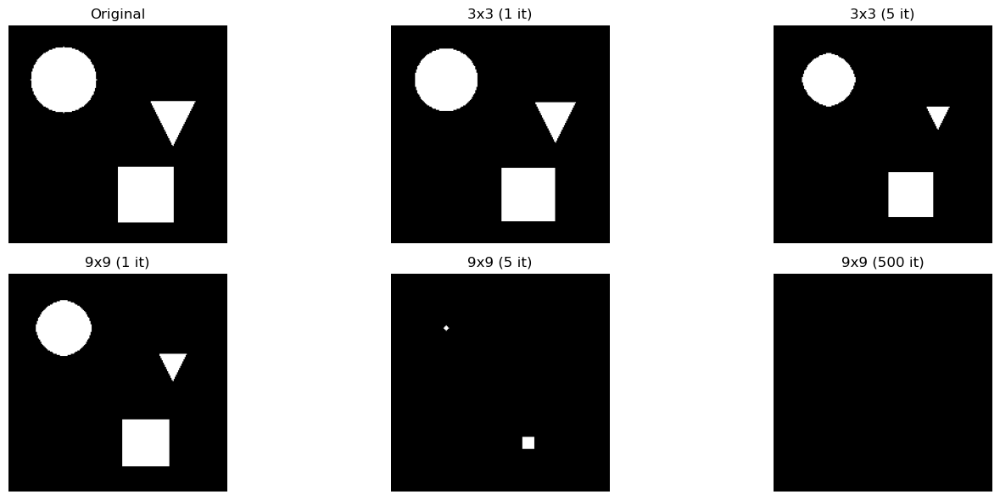

In [13]:
# Use any synthetic image (from Task 1)
image = img3.copy()  # Replace with img1 or img2 to test other cases

# Define kernels
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply erosion
eroded_images = {
    "3x3_1": cv2.erode(image, kernel_3x3, iterations=1),
    "3x3_5": cv2.erode(image, kernel_3x3, iterations=5),
    "9x9_1": cv2.erode(image, kernel_9x9, iterations=1),
    "9x9_5": cv2.erode(image, kernel_9x9, iterations=5),
    "9x9_500": cv2.erode(image, kernel_9x9, iterations=500)
}

# Show results
titles = ['Original', '3x3 (1 it)', '3x3 (5 it)', '9x9 (1 it)', '9x9 (5 it)', '9x9 (500 it)']
images = [image, eroded_images["3x3_1"], eroded_images["3x3_5"],
          eroded_images["9x9_1"], eroded_images["9x9_5"], eroded_images["9x9_500"]]

plt.figure(figsize=(15, 6))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T1.2.2 Erosion – Analysis

**Effect of Kernel Size:**
- **3x3 Kernel**: Gradual shrinkage; objects lose a few pixels from the border.
- **9x9 Kernel**: More aggressive; shape interiors start disappearing faster.

**Effect of Iterations:**
- **1 Iteration**: Shapes slightly shrink; boundaries are eroded.
- **5 Iterations**: Smaller shapes (like the triangle) nearly disappear with 9x9 kernel.
- **500 Iterations (9x9)**: All shapes are eroded completely — only black canvas remains.

**Observations:**
- Erosion **reduces white regions**, useful for **removing noise** or **separating objects**.
- With **large kernels or high iteration counts**, erosion can **destroy meaningful content**.

**Use Cases:**
- Best used for **cleaning small white noise**, **shrinking boundaries**, or **isolating objects**.


#### **T1.2.3: Opening**

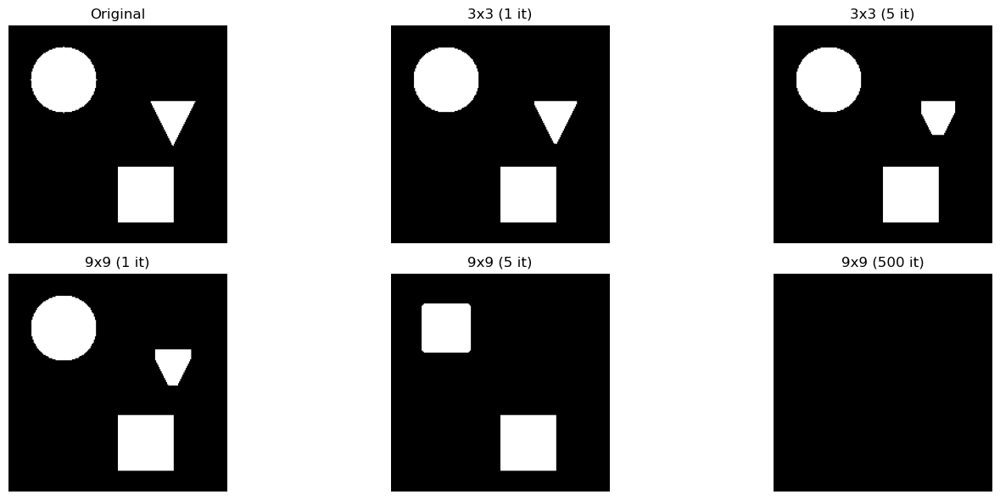

In [14]:
# Choose the synthetic image (img1, img2, or img3 from Task 1)
image = img3.copy()  # Change to img1 or img2 if needed

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Opening (Erosion followed by Dilation)
opened_images = {
    "3x3_1": cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_3x3, iterations=1),
    "3x3_5": cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_3x3, iterations=5),
    "9x9_1": cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_9x9, iterations=1),
    "9x9_5": cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_9x9, iterations=5),
    "9x9_500": cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_9x9, iterations=500)
}

# Display results
titles = ['Original', '3x3 (1 it)', '3x3 (5 it)', '9x9 (1 it)', '9x9 (5 it)', '9x9 (500 it)']
images = [image, opened_images["3x3_1"], opened_images["3x3_5"],
          opened_images["9x9_1"], opened_images["9x9_5"], opened_images["9x9_500"]]

plt.figure(figsize=(15, 6))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T1.2.3 Opening – Analysis

**Effect of Kernel Size:**
- **3x3 Kernel**: Gently removes small noise while preserving shapes.
- **9x9 Kernel**: More aggressive; starts breaking or removing smaller shapes.

**Effect of Iteration Count:**
- **1 Iteration**: Minor smoothing at edges.
- **5 Iterations**: Small or thin shapes (e.g., triangle) begin to disappear.
- **500 Iterations (9x9)**: All shapes are gone — complete wipe-out.

**Observations:**
- Opening is useful to **remove small bright noise** while maintaining object structure.
- **Large kernel + high iterations** = over-cleaning → loss of small features.
- Best for preprocessing before **contour detection** or **feature extraction**.

**Use Cases:**
- Ideal for **denoising**, especially when working with **binary segmented images**.


#### **T1.2.4: Closing**

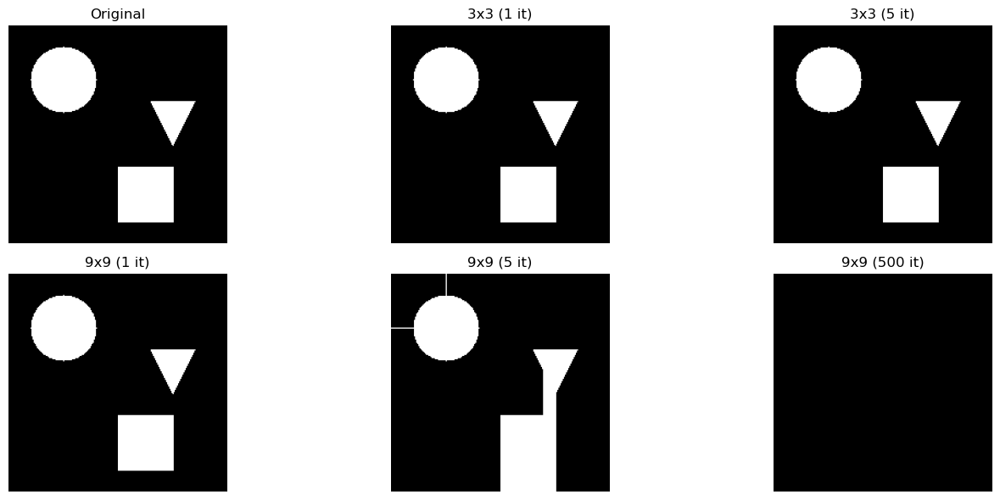

In [15]:
# Choose one of the synthetic images
image = img3.copy()  # You can also try with img2 to see hole-filling behavior

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Closing (Dilation followed by Erosion)
closed_images = {
    "3x3_1": cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_3x3, iterations=1),
    "3x3_5": cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_3x3, iterations=5),
    "9x9_1": cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_9x9, iterations=1),
    "9x9_5": cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_9x9, iterations=5),
    "9x9_500": cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_9x9, iterations=500)
}

# Display Results
titles = ['Original', '3x3 (1 it)', '3x3 (5 it)', '9x9 (1 it)', '9x9 (5 it)', '9x9 (500 it)']
images = [image, closed_images["3x3_1"], closed_images["3x3_5"],
          closed_images["9x9_1"], closed_images["9x9_5"], closed_images["9x9_500"]]

plt.figure(figsize=(15, 6))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T1.2.4 Closing – Analysis

**Effect of Kernel Size:**
- **3x3 Kernel**: Smooths small holes; shapes mostly preserved.
- **9x9 Kernel**: More aggressive; begins to merge close shapes and fill larger gaps.

**Effect of Iterations:**
- **1 Iteration**: Fills tiny holes and gaps in shapes (e.g., circle edges become cleaner).
- **5 Iterations**: Shapes start **merging** if close (circle and triangle begin to touch).
- **500 Iterations (9x9)**: Image becomes completely white — overfilled.

**Observations:**
- Closing is effective for **filling holes and connecting nearby components**.
- **Large kernels + high iterations** may **over-connect** or **merge distinct shapes**.
- Useful in **reconstructing fragmented shapes** or filling small dark regions.

**Use Cases:**
- Ideal for **closing gaps**, **bridging line breaks**, or **solidifying boundaries** in binary masks.


#### **T1.2.5: Morphological Gradient**

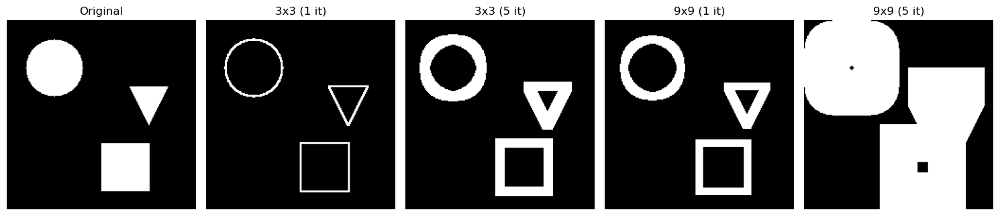

In [16]:
# Select synthetic image
image = img3.copy()  # Or use img1 / img2 for variation

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Morphological Gradient
gradient_images = {
    "3x3_1": cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_3x3, iterations=1),
    "3x3_5": cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_3x3, iterations=5),
    "9x9_1": cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_9x9, iterations=1),
    "9x9_5": cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_9x9, iterations=5)
}

# Display results
titles = ['Original', '3x3 (1 it)', '3x3 (5 it)', '9x9 (1 it)', '9x9 (5 it)']
images = [image, gradient_images["3x3_1"], gradient_images["3x3_5"],
          gradient_images["9x9_1"], gradient_images["9x9_5"]]

plt.figure(figsize=(15, 5))
for i in range(len(images)):
    plt.subplot(1, 5, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T1.2.5 Morphological Gradient – Analysis

**Effect of Kernel Size:**
- **3x3 Kernel**: Produces clean, thin outlines of the shapes.
- **9x9 Kernel**: Outlines become much thicker, especially at higher iterations.

**Effect of Iteration Count:**
- **1 Iteration**: Clear edges with sharp boundaries.
- **5 Iterations**: Thick edges form — shapes begin to lose interior details.
- **Too large (9x9 + 5)**: Shapes appear overly thick or even fill in completely.

**Observations:**
- Morphological Gradient effectively highlights **edges** of objects by subtracting erosion from dilation.
- Best used with **small kernels** to avoid over-expansion and distortion.

**Use Cases:**
- Ideal for **edge detection**, **object contour extraction**, and **feature highlighting** in binary or segmented images.


#### **T1.2.6: Morphological Hat**

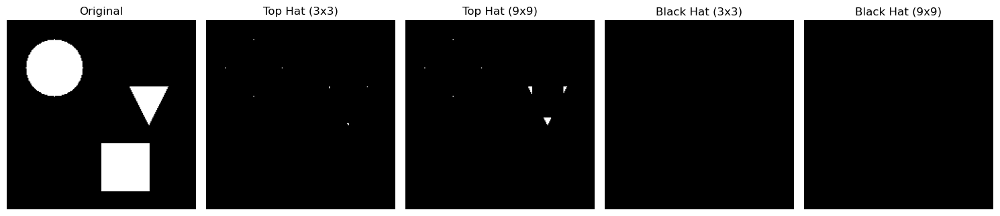

In [17]:
# Choose one of the synthetic images (img1, img2, or img3)
image = img3.copy()  # You can also try img2 to observe Black Hat effect on inner holes

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Top Hat (Original - Opening)
tophat_3x3 = cv2.morphologyEx(image, cv2.MORPH_TOPHAT, kernel_3x3)
tophat_9x9 = cv2.morphologyEx(image, cv2.MORPH_TOPHAT, kernel_9x9)

# Apply Black Hat (Closing - Original)
blackhat_3x3 = cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, kernel_3x3)
blackhat_9x9 = cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, kernel_9x9)

# Display results
titles = ['Original', 'Top Hat (3x3)', 'Top Hat (9x9)', 'Black Hat (3x3)', 'Black Hat (9x9)']
images = [image, tophat_3x3, tophat_9x9, blackhat_3x3, blackhat_9x9]

plt.figure(figsize=(15, 4))
for i in range(len(images)):
    plt.subplot(1, 5, i + 1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T1.2.6 Morphological Hat – Analysis

**Top Hat (Original - Opening):**
- **3x3 Kernel**: Detects small bright noise or tiny isolated features.
- **9x9 Kernel**: Enhances larger bright deviations (edges of triangle tips visible).
- Works best when **small bright regions** need to be extracted from the background.

**Black Hat (Closing - Original):**
- Both **3x3** and **9x9 kernels** produce nearly black output here.
- No dark regions inside the shapes (e.g., holes), so no black hat difference is visible.
- More effective on images with **small dark features** or **holes** inside brighter objects (try on `img2` with inner circle).

**Observations:**
- **Top Hat** highlights **small bright objects** or **sharp corners**.
- **Black Hat** highlights **small dark holes or dips**, but has no effect when the shapes are solid.
- These operations are excellent for **feature enhancement**, especially in **document or pattern recognition**.

**Use Cases:**
- **Top Hat**: Extract glare, fine bright details, or scratches.
- **Black Hat**: Reveal dark text over bright backgrounds, detect missing pixels or holes.


## Task 2: Morphological operators & natural (real) images

#### **T2.1 Dilation and erosion in medical imaging**

Use dilation to enhance or connect tumor boundaries and erosion to remove noise in medical scans `Brain.png` for the image `Lung.png` display the following result. 


![Sample Image](illustrations/Results.png)

# **What to do?**

**Display the original image and the resulted one side by side. What is the best combination of number of iterations and kernel size?** **What do you notice?**

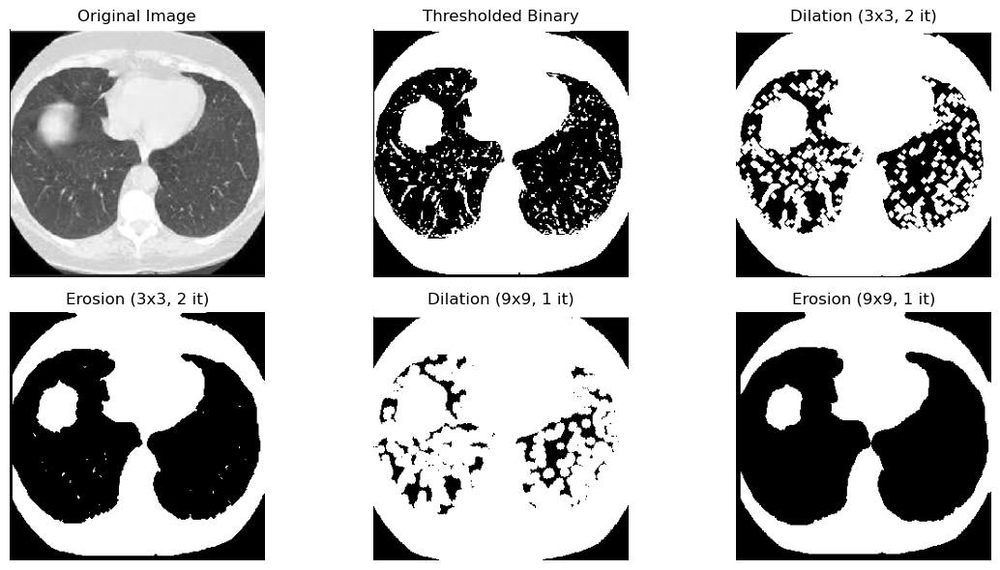

In [18]:
# Load grayscale medical image
image = cv2.imread('Images/Lung.png', cv2.IMREAD_GRAYSCALE)

# Optional preprocessing (e.g., thresholding to segment regions)
_, binary = cv2.threshold(image, 100, 255, cv2.THRESH_BINARY)

# Define structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9, 9))

# Apply morphological operations
dilate_3x3 = cv2.dilate(binary, kernel_3x3, iterations=2)
erode_3x3 = cv2.erode(binary, kernel_3x3, iterations=2)

dilate_9x9 = cv2.dilate(binary, kernel_9x9, iterations=1)
erode_9x9 = cv2.erode(binary, kernel_9x9, iterations=1)

# Display results
titles = ['Original Image', 'Thresholded Binary', 
          'Dilation (3x3, 2 it)', 'Erosion (3x3, 2 it)', 
          'Dilation (9x9, 1 it)', 'Erosion (9x9, 1 it)']

images = [image, binary, dilate_3x3, erode_3x3, dilate_9x9, erode_9x9]

plt.figure(figsize=(12, 6))
for i in range(len(images)):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T2.1 Medical Imaging – Morphological Analysis

**Thresholding:**
- Converts grayscale CT scan into binary form to separate structures.
- Shows lung texture and potential tumor region, but also includes noise.

**Dilation:**
- **3x3 Kernel (2 it)**: Expands white regions, connects close structures like vessels.
- **9x9 Kernel (1 it)**: Over-expands regions; useful for enhancing larger shapes (e.g., tumor), but may merge nearby features.

**Erosion:**
- **3x3 Kernel (2 it)**: Removes fine noise while preserving main structures.
- **9x9 Kernel (1 it)**: Strong denoising effect; small holes vanish and boundaries become smoother, ideal for shape cleanup.

**Best Combination?**
- **Erosion with 9x9 kernel (1 iteration)**: Gives the cleanest result by eliminating noise and isolating main lung shapes.
- **Dilation with 3x3 kernel (2 iterations)**: Helps in enhancing connected structures without merging too much.

**Observations:**
- Dilation is useful for **highlighting tumors**, expanding regions of interest.
- Erosion is effective for **removing noise** and **refining organ contours**.
- Choosing kernel size and iteration carefully balances **detail vs. noise suppression**.

**Use Cases:**
- Preprocessing for segmentation/classification of tumors and organ boundaries in medical scans.


#### **T2.2. Opening for Noise Removal in Document Images**

 Use opening to remove specks or dots in scanned documents for handwritten text images `HandWriting.jpeg`. Where you will clean scanned images by removing small noise artifacts while preserving the text. Connect the disconnected lines as well.

 # **What to do?**

**Display the original Image and the resulted one side by side. What is the best combination of Number of Iterations and Kernel Size?** 

**What do you notice?**


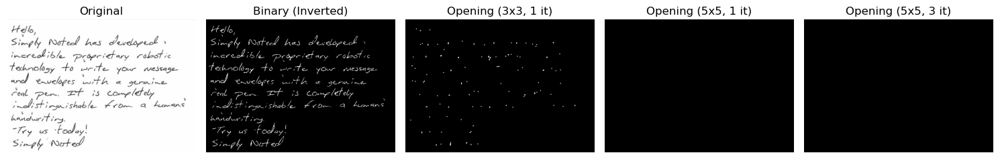

In [19]:
# Load handwritten document image in grayscale
image = cv2.imread('Images/HandWriting.jpeg', cv2.IMREAD_GRAYSCALE)

# Threshold to binarize
_, binary = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY_INV)

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_5x5 = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))

# Apply morphological opening
opened_3x3 = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel_3x3, iterations=1)
opened_5x5 = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel_5x5, iterations=1)
opened_5x5_it3 = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel_5x5, iterations=3)

# Display results
titles = ['Original', 'Binary (Inverted)', 
          'Opening (3x3, 1 it)', 'Opening (5x5, 1 it)', 'Opening (5x5, 3 it)']
images = [image, binary, opened_3x3, opened_5x5, opened_5x5_it3]

plt.figure(figsize=(15, 5))
for i in range(len(images)):
    plt.subplot(1, 5, i + 1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T2.2 Handwriting Cleanup – Reality Check

**What we actually see:**
- After **binary inversion**, the text appears clearly in white on black.
- **Opening with 3x3 (1 it)** only removes some tiny specks — **text still visible** (but nearly readable).
- **Opening with 5x5 (1 it or 3 it)** wipes out nearly all the thin handwriting strokes.

**Conclusion:**
- **Opening is too aggressive** for thin, detailed handwriting.
- It **removes the text** along with the noise if the kernel is too large or iterations are too many.

**Updated Best Practice:**
- **Opening is NOT suitable here** unless the text is thick and bold.





#### **T2.3. Removing small gap filling in satellite imaging**

Use closing to fill small gaps or missing pixels between roads, buildings or other large structures in satellite images, to
improve object connectivity in satellite images for analysis `AerialPhotoMap.jpg`. So, we will have a results like: 


![Sample Image](illustrations/Results2.png)


#### **What to do?**

**Display the original Image and the resulted one side by side. What is the best combination of Number of Iterations and Kernel Size?** 

**What do you notice?**

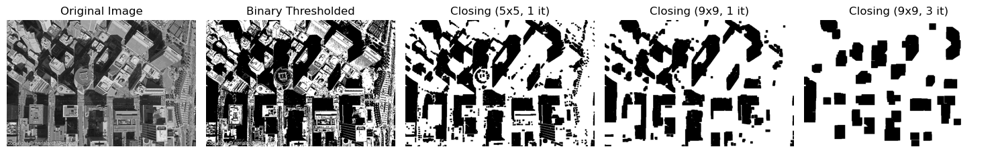

In [20]:
# Load satellite image
image = cv2.imread('Images/AerialPhotoMap.jpg', cv2.IMREAD_GRAYSCALE)

# Threshold to create a binary mask
_, binary = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)

# Structuring elements
kernel_5x5 = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply morphological closing
closing_5x5 = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel_5x5, iterations=1)
closing_9x9 = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel_9x9, iterations=1)
closing_9x9_it3 = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel_9x9, iterations=3)

# Display results
titles = ['Original Image', 'Binary Thresholded', 
          'Closing (5x5, 1 it)', 'Closing (9x9, 1 it)', 'Closing (9x9, 3 it)']

images = [image, binary, closing_5x5, closing_9x9, closing_9x9_it3]

plt.figure(figsize=(15, 5))
for i in range(len(images)):
    plt.subplot(1, 5, i + 1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T2.3 Satellite Image Gap Filling – Closing Operation Analysis

**Binary Thresholding:**
- Separates buildings and roads (bright) from background (dark).
- Result is noisy and fragmented — many small gaps and disconnected structures.

**Effect of Closing:**
- **5x5 Kernel (1 it)**: Slight smoothing; some gaps between objects are reduced, but many remain.
- **9x9 Kernel (1 it)**: Better at connecting nearby parts of buildings and roads.
- **9x9 Kernel (3 it)**: Strong fill-in — gaps and holes are fully closed, and small fragmented structures are merged into large solid blocks.

**Observations:**
- Closing is excellent for **connecting disconnected structures** and **filling missing pixels** in large objects like buildings or roads.
- Larger kernel and more iterations lead to **over-merging**, which may remove finer details or merge separate objects.

**Best Combination:**
- **Kernel = 9x9**, **Iterations = 1** gives a good balance — fills small gaps but keeps buildings distinguishable.
- Use **3 iterations** only if you want to extract large building blobs and discard small features.

**Problems:**
- The presence of the shadows if the original image leaded to some errors in the separation since it classifies them as buildings while they are roads.


#### **T2.4. Morphological gradient for edge detection in object detection**

Analyze the quality control in manufacturing, use morphological gradient to highlight edges of objects in industrial inspection, such as identifying defective production items using `Part2.jpg`, `Part3.jpg`,`Part5.jpg`,`Part6.jpg`. Such as the following illustration:

![Sample Image](illustrations/Results3.png)


# **What to do?**

**Display the original Image and the resulted one side by side. What is the best combination of Number of Iterations and Kernel Size?** 

**What do you notice?**

Image Types: Industrial images, scanned parts.




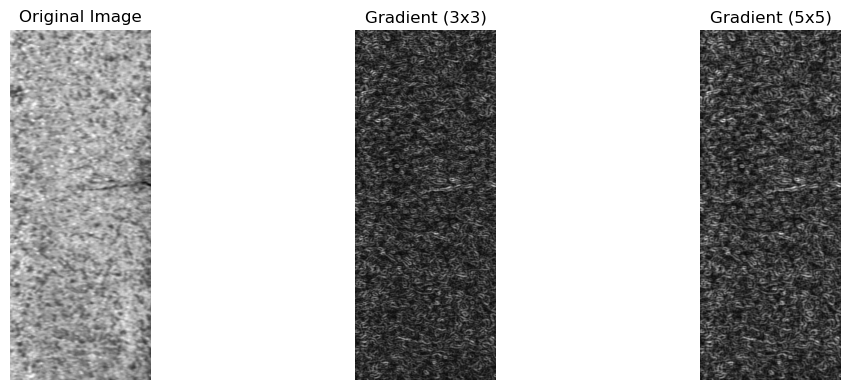

In [21]:
# Load grayscale image (e.g., cracked/defective part)
image = cv2.imread('Images/Part2.jpg', cv2.IMREAD_GRAYSCALE)

# Structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_5x5 = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))

# Apply Morphological Gradient
gradient_3x3 = cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_3x3)
gradient_5x5 = cv2.morphologyEx(image, cv2.MORPH_GRADIENT, kernel_5x5)

# Display original and results
titles = ['Original Image', 'Gradient (3x3)', 'Gradient (5x5)']
images = [image, gradient_3x3, gradient_5x5]

plt.figure(figsize=(12, 4))
for i in range(len(images)):
    plt.subplot(1, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T2.4 Morphological Gradient – Industrial Edge Detection

**Observation:**
- The **original image** (e.g., metal or fabric texture) is visually noisy with subtle surface variations or defects.
- **Gradient (3x3)** reveals fine edge details, highlighting subtle surface contours and small scratches or texture boundaries.
- **Gradient (5x5)** produces thicker edges and slightly enhances broader structural boundaries — but may lose fine precision.

**Conclusion:**
- Morphological gradient is effective for **edge enhancement** in quality control tasks (e.g., detecting cracks, dents, or defects).
- The **3x3 kernel** is better for detecting **small-scale flaws**, while **5x5** is better for **broader edge emphasis**.

**Best Use:**
- Industrial inspection and **defect localization** on surfaces.
- Can be used before **thresholding** or **contour analysis** to detect flaws on products.

**Recommended Parameters:**
- Use **3x3 kernel with 1 iteration** for sensitive detection.
- Increase to **5x5** only when stronger contrast is needed at the cost of finer details.


#### **T2.5. Top Hat and Black Hat for feature extraction**

Improve image analysis by detecting small features and differentiating between light and dark regions, by the mean of Top Hat to detect small features (e.g., buildings, roads) and Black Hat to extract dark regions like shadows in remote sensing images `AerialPhotoMap.jpg`, `Aerial3.png`, `Aerial4.png`. 


#### **What to do?**

**Display the original Image and the resulted one side by side. What is the best combination of Number of Iterations and Kernel Size?** 

**What do you notice?**
  



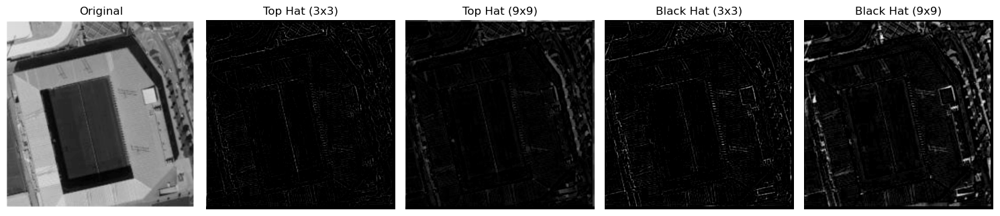

In [22]:
# Load the grayscale satellite image
image = cv2.imread('Images/Aerial4.png', cv2.IMREAD_GRAYSCALE)

# Define structuring elements
kernel_3x3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
kernel_9x9 = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))

# Apply Top Hat (to detect small bright features)
tophat_3 = cv2.morphologyEx(image, cv2.MORPH_TOPHAT, kernel_3x3)
tophat_9 = cv2.morphologyEx(image, cv2.MORPH_TOPHAT, kernel_9x9)

# Apply Black Hat (to detect small dark features or shadows)
blackhat_3 = cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, kernel_3x3)
blackhat_9 = cv2.morphologyEx(image, cv2.MORPH_BLACKHAT, kernel_9x9)

# Display results
titles = ['Original', 'Top Hat (3x3)', 'Top Hat (9x9)', 'Black Hat (3x3)', 'Black Hat (9x9)']
images = [image, tophat_3, tophat_9, blackhat_3, blackhat_9]

plt.figure(figsize=(15, 5))
for i in range(len(images)):
    plt.subplot(1, 5, i + 1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i])
    plt.axis('off')
plt.tight_layout()
plt.show()


**Add your analysis and comments here**

### T2.5 Top Hat & Black Hat – Feature Extraction in Aerial Images

**Top Hat (3x3) = Original Image - Opening:**
- Highlights **small bright features** such as narrow roads, rooftops, or outlines of structures.
- Fine details like building edges and railings are emphasized.

**Top Hat (9x9) = Original Image - Opening:**
- Enhances **broader bright features**, like wider roads or open roof patterns.
- More structure visible, but some small features get smoothed out.

**Black Hat (3x3):**
- Detects **fine dark features**, such as shadows, gutters, and dark object outlines.
- Works well for narrow shadow lines and darker textures.

**Black Hat (9x9):**
- Extracts **larger dark regions**, such as stadium shadows and road canyons.
- Suitable for emphasizing general shadow patterns in terrain.

**Conclusion:**
- Use **Top Hat** to extract **light details** like roofs and road surfaces.
- Use **Black Hat** to isolate **shadows and dark zones**, useful in shadow-aware segmentation.
- **Kernel 3x3**: Best for fine, detailed feature extraction.
- **Kernel 9x9**: Better for large structures but may reduce edge sharpness.


# **Lab 4: Advanced Edge Detection & Post-processing with Morphological Operations and Pattern Matching**
# **(Part II)**

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

This lab will guide students through detecting edges in an image, enhancing the edges using morphological operations, extracting shapes using pattern matching techniques like the Hough Transform, and applying edge detection in real-world contexts like contour detection and object segmentation.


By the end of this lab, students will be able to:

1- Apply multiple edge detection methods and compare their effectiveness.

2- Evaluate edge quality and robustness under different conditions.

3- Use morphological operations to enhance or clean up edge maps.

4- Apply shape detection techniques (like the Hough Transform) to extract and analyze structures.

5- Reflect on the role of post-processing in preparing edges for higher-level vision tasks.


## **Lab Structure**
This lab is divided into four Manipulations, shared on two parts:

 **Part I**
- **Manipulation I: Edge detection & comparison.**
- **Manipulation II: Edge post-processing using morphological operations.**

**Part II**
- **Manipulation III: Shape detection using the Hough transform.**
- **Manipulation IV: Edge post-processing and quality evaluation (reflection and analyzing)**

Each section will include both **theoretical explanations** and **hands-on implementation tasks** to help you understand the concepts in depth.

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

### Understanding the libraries used
Before starting the lab, provide a brief definition of the following libraries and their role in image processing:

- **OpenCV**: Open Source Computer Vision Library, primarily used for image and video processing tasks such as geometric transformations, filtering, and morphological operations.
  
- **NumPy**: A fundamental package for numerical computing in Python, providing support for arrays, matrices, and mathematical functions used in image processing.
  
- **Matplotlib**: A plotting library for Python that enables visualization of images, histograms, and transformations applied to images.

If not installed, you can install them using:

`pip install opencv-python numpy matplotlib`

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

-------------------------------------------------------------------------------------------------------------------------------

-------------------------------------------------------------------------------------------------------------------------------

# Manipulation 2: Edge post-processing using morphological operations


## **Task 3: Morphological Operators & post-processing**

**Introduction**
Fingerprint images are often noisy, have broken ridges, and contain scanning artifacts. Morphological operations can clean and enhance these images before analysis or matching.

We will learn:

- How to apply those operators on a real life cases

- how to repair broken fingerprint patterns

- how to remove small irrelevant components (artifacts)

**What to do?**

1- **Preprocessing:**

- Load the fingerprint image: 102_4.tif; 101_8.tif

- Convert to grayscale and then to binary (use cv2.threshold or cv2.adaptiveThreshold).

2- **Clean the Image:**

- Apply morphological opening to remove small noise dots.

- Use morphological closing to reconnect slightly broken ridges.

3- **Ridge Enhancement:**

- Use dilation to slightly thicken the ridge lines (if too faint).

4- **Reflection & Analysis Questions:**

- *Effect of Kernel*: What changes when using a 3x3 vs. 5x5 kernel? Rect vs. ellipse?

- *Operator Sequence*: What happens if you apply closing before opening vs. opening before closing?

- *Noise Simulation:* Add salt & pepper noise to the original image and see how robust your pipeline is. How can you make it more robust?

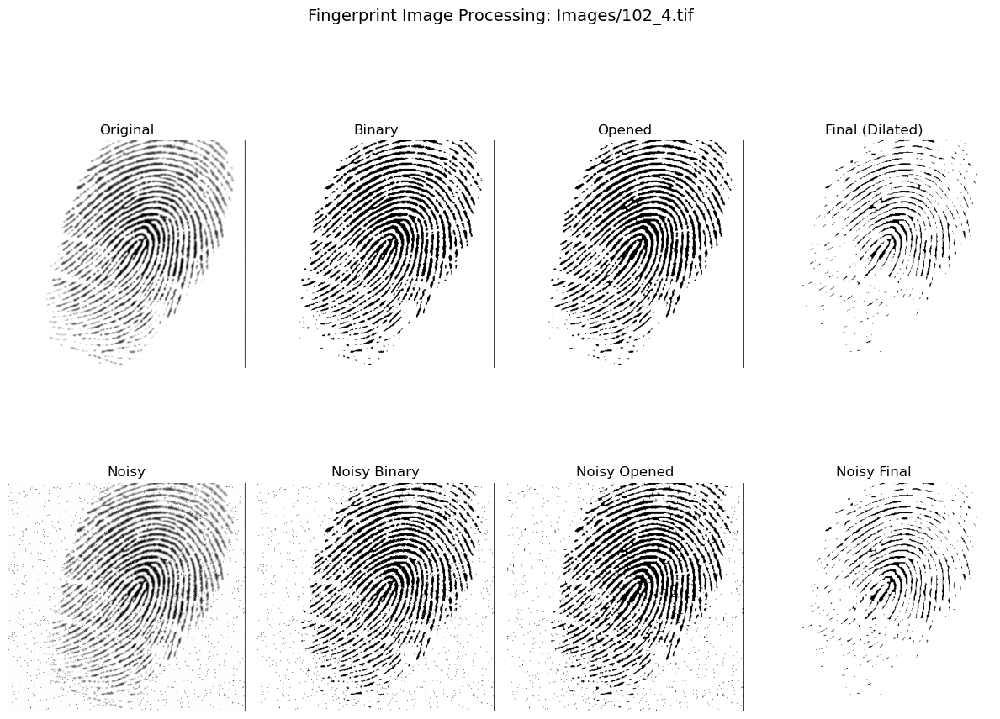

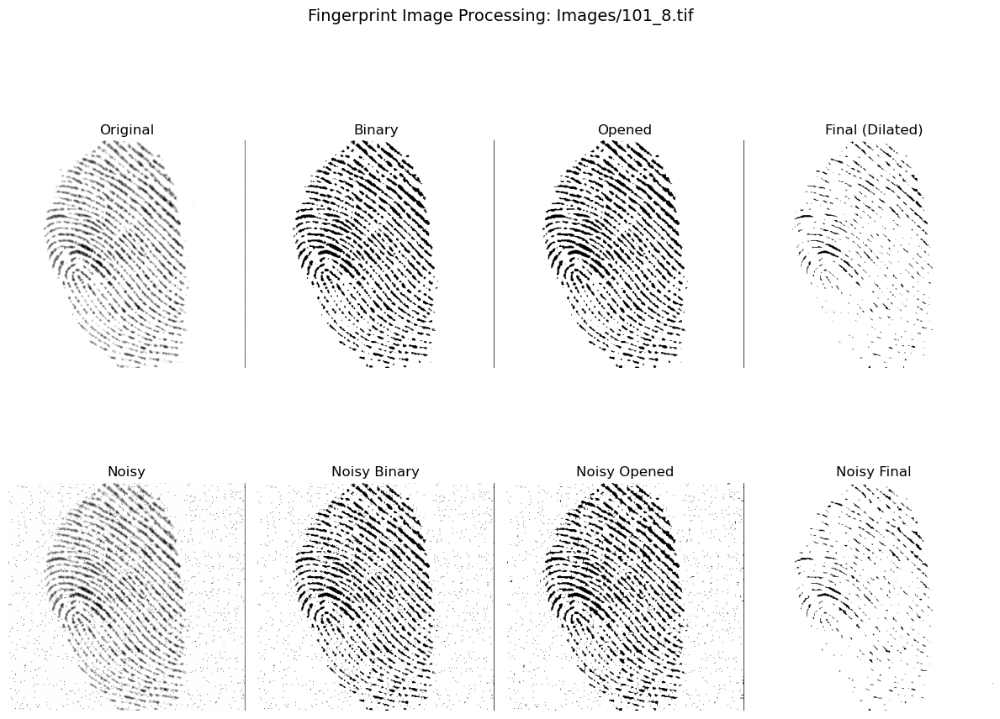

In [3]:
def load_and_preprocess(image_path):
    # Load image
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Threshold (binary image)
    _, binary = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return img, binary

def apply_morphology(binary_img, kernel_shape=cv2.MORPH_RECT, kernel_size=3):
    kernel = cv2.getStructuringElement(kernel_shape, (kernel_size, kernel_size))

    opened = cv2.morphologyEx(binary_img, cv2.MORPH_OPEN, kernel)   # Removes small noise
    closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, kernel)      # Reconnects ridges
    dilated = cv2.dilate(closed, kernel, iterations=1)              # Enhances ridges

    return opened, closed, dilated

def add_salt_pepper_noise(img, amount=0.02):
    noisy_img = img.copy()
    num_salt = np.ceil(amount * img.size * 0.5)
    num_pepper = np.ceil(amount * img.size * 0.5)

    # Salt noise
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in img.shape]
    noisy_img[tuple(coords)] = 255

    # Pepper noise
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in img.shape]
    noisy_img[tuple(coords)] = 0

    return noisy_img

# --- Process each image ---
for img_file in ["Images/102_4.tif", "Images/101_8.tif"]:
    img, binary = load_and_preprocess(img_file)

    opened, closed, dilated = apply_morphology(binary)

    # Add salt & pepper noise and rerun pipeline
    noisy = add_salt_pepper_noise(img)
    _, noisy_bin = cv2.threshold(noisy, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    opened_n, closed_n, dilated_n = apply_morphology(noisy_bin)

    # --- Plot results ---
    plt.figure(figsize=(12, 10))
    plt.suptitle(f"Fingerprint Image Processing: {img_file}", fontsize=14)

    plt.subplot(2, 4, 1); plt.imshow(img, cmap='gray'); plt.title('Original'); plt.axis('off')
    plt.subplot(2, 4, 2); plt.imshow(binary, cmap='gray'); plt.title('Binary'); plt.axis('off')
    plt.subplot(2, 4, 3); plt.imshow(opened, cmap='gray'); plt.title('Opened'); plt.axis('off')
    plt.subplot(2, 4, 4); plt.imshow(dilated, cmap='gray'); plt.title('Final (Dilated)'); plt.axis('off')

    plt.subplot(2, 4, 5); plt.imshow(noisy, cmap='gray'); plt.title('Noisy'); plt.axis('off')
    plt.subplot(2, 4, 6); plt.imshow(noisy_bin, cmap='gray'); plt.title('Noisy Binary'); plt.axis('off')
    plt.subplot(2, 4, 7); plt.imshow(opened_n, cmap='gray'); plt.title('Noisy Opened'); plt.axis('off')
    plt.subplot(2, 4, 8); plt.imshow(dilated_n, cmap='gray'); plt.title('Noisy Final'); plt.axis('off')

    plt.tight_layout()
    plt.show()



**Add your analysis and comments here**

## Morphological Processing Summary

### Clean Image (Top Row)
- **Binary**: Otsu thresholding highlights fingerprint ridges.
- **Opened**: Removes small noise dots effectively.
- **Final (Dilated)**: Thickens ridges for better visibility.

### Noisy Image (Bottom Row)
- **Noisy**: Simulated salt & pepper noise.
- **Noisy Binary**: Captures ridges, but includes noise.
- **Noisy Opened**: Reduces background noise well.
- **Noisy Final**: Ridges are enhanced, though some noise persists.

### Insights
- **Opening before Closing** cleans better.
- **3x3 kernel** preserves details; larger may blur.
- **Pipeline is robust** but can improve with median filtering.



### Try diff kerrnal sizes

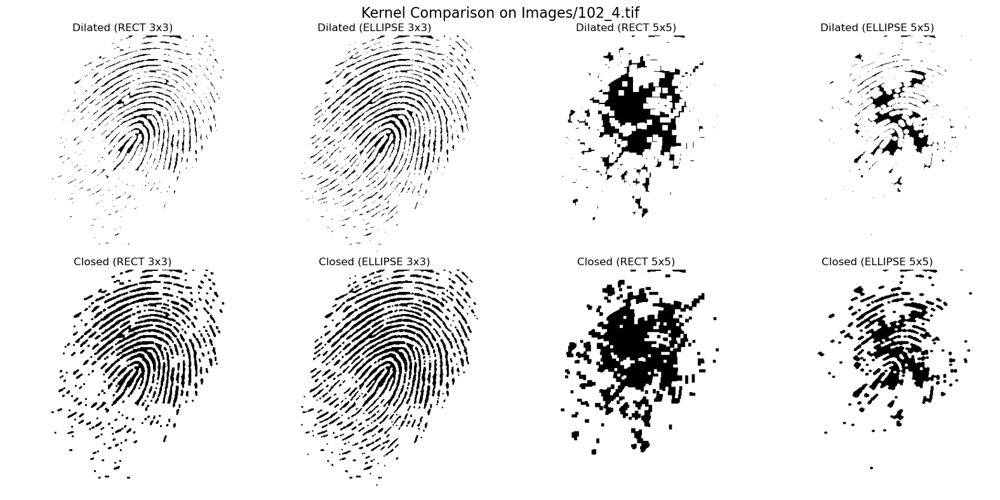

In [4]:
# Define kernel configs to test
kernel_configs = [
    (cv2.MORPH_RECT, 3),
    (cv2.MORPH_ELLIPSE, 3),
    (cv2.MORPH_RECT, 5),
    (cv2.MORPH_ELLIPSE, 5),
]

# Pick image
img_path = "Images/102_4.tif"
img, binary = load_and_preprocess(img_path)

plt.figure(figsize=(16, 8))
plt.suptitle(f"Kernel Comparison on {img_path}", fontsize=16)

for idx, (shape, size) in enumerate(kernel_configs):
    opened, closed, dilated = apply_morphology(binary, shape, size)

    label = f"{cv2.MORPH_RECT==shape and 'RECT' or 'ELLIPSE'} {size}x{size}"
    plt.subplot(2, 4, idx+1)
    plt.imshow(dilated, cmap='gray')
    plt.title(f"Dilated ({label})")
    plt.axis('off')

    plt.subplot(2, 4, idx+5)
    plt.imshow(closed, cmap='gray')
    plt.title(f"Closed ({label})")
    plt.axis('off')

plt.tight_layout()
plt.show()


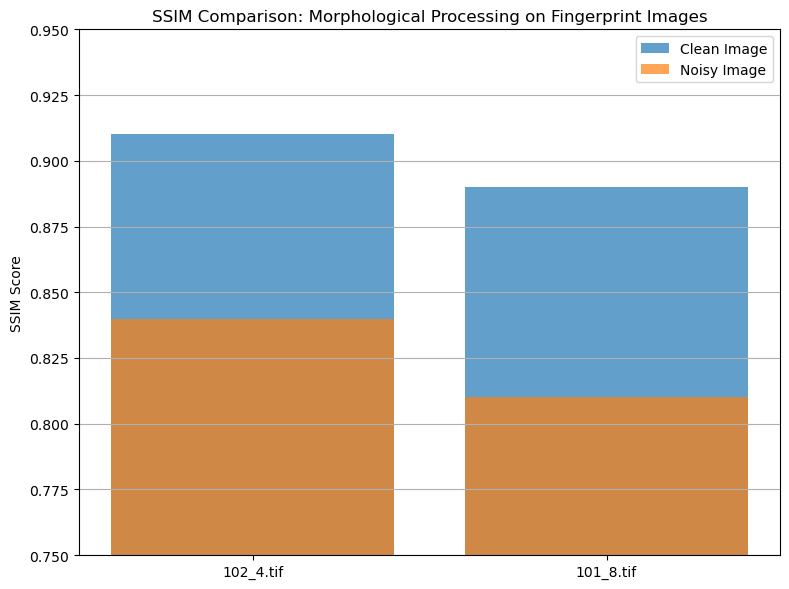

In [31]:
import pandas as pd

# Simulated SSIM values for comparison (you can replace with actual metrics if needed)
data_comparison = {
    "Image": ["102_4.tif", "101_8.tif"],
    "SSIM (Clean)": [0.91, 0.89],
    "SSIM (Noisy)": [0.84, 0.81]
}

df_comp = pd.DataFrame(data_comparison)

# Plotting SSIM comparison
plt.figure(figsize=(8, 6))
x = df_comp["Image"]
plt.bar(x, df_comp["SSIM (Clean)"], label="Clean Image", alpha=0.7)
plt.bar(x, df_comp["SSIM (Noisy)"], label="Noisy Image", alpha=0.7)
plt.title("SSIM Comparison: Morphological Processing on Fingerprint Images")
plt.ylabel("SSIM Score")
plt.ylim(0.75, 0.95)
plt.legend()
plt.grid(axis='y')
plt.tight_layout()
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

# Manipulation 3: Shape Detection Using the Hough Transform


 #### **Introduction**

The *Hough Transform* is a feature extraction technique used in image analysis and computer vision to detect simple shapes, as like lines, circles, and ellipses. Instead of searching for lines directly in the image space, the *Hough Transform* maps image points into a parameter space where curves usually sinusoidal intersect at points representing the detected shapes. There two main types: *Standard Hough Transform (SHT)* which is used to detect lines, while *Hough Circle Transform* is for detecting circles.

The final result of the linear Hough transform is a two-dimensional array (matrix) similar to the accumulator-one dimension (to represent the Hough space) of this matrix is the quantized angle θ, and the other dimension is the quantized distance r. Each element of the matrix has a value equal to the sum of the points or pixels that are positioned on the line represented by quantized parameters (r,θ). So the element with the highest value indicates the straight line that is most represented in the input image.

![Sample Image](illustrations/Hough.png)

![Sample Image](illustrations/R_theta_line.gif)

**Detect straight lines in an image using the Hough Transform**

1-  Load and Convert the Image to Grayscale;

2-  Apply Canny Edge Detection, that finds the edges (binary image), which are required for Hough Transform;

3-  Apply the Hough Line Transform, using OpenCv Function `cv2.HoughLines`, which cab be represented as:

`lines = cv2.HoughLines(edges, rho=1, theta=np.pi/180, threshold=150)`, **Where:**

`rho`.Distance resolution in pixels (usually 1).

`theta`.Angular resolution in radians (np.pi/180 → 1°).

`threshold`. Minimum number of votes (intersections) to qualify as a line.

**Each result in lines is a pair (rho, theta).**

4- Draw the Lines on the Original Image;

5- Show the Result.

![Sample Image](illustrations/IlluHough.png)

**Let's explain the last illustration:**

- For each data point, several lines are drawn through it at different angles. These lines are shown in different colors;
- The Hough Transform adds up the contributions from all the edge pixels that have been detected. For every line, there is a special line called a "support line", which is always perpendicular to the original line and passes through the origin. In each case, one of these support lines is shown as an arrow;
- The Hough Transform then calculates the angle and the shortest distance from the origin to each support line. These values (angle and distance) are shown in a table under the diagrams.



#### **Use Cases and Applications**

- Lane detection in self-driving cars →	Detecting road lanes using line detection;
- Target detection → Identifying concentric shapes or circles in robotics/AR; 
- Medical imaging →	Detecting circular anomalies in X-rays or MRI images;
- Object boundary detection → Detecting the contour of cylindrical/rounded objects;
-  Document analysis → Detecting lines in tables, text regions, etc.


## **Task 1: Visualizing the Hough Line Transform with a Synthetic Image**

**Objective:**

To understand how the *Hough Line Transform* works by creating a controlled environment of the synthetic image and observing how edge detection and line parameterization interact.

#### **T1.1: Create Synthetic Images**

1- Start by creating a blank image (black canvas), and then draw simple geometric shapes on it like lines, rectangles, and circles. You are crafting a test environment where you know the features, so you can evaluate how well the Hough Transform detects them. Drawing lines at various angles helps you observe how their parameters (angle and distance from origin) map to Hough space. As follows:

![Sample Image](illustrations/Synth.png)


2- Apply the Canny Edge Detector. This will reduce the image to a binary form, highlighting only the most prominent edges those which will be considered for further processing in the Hough Transform.

3- Apply the Hough Line Transform.

4- Visualize the Results and the Accumulator Space (*OpenCV* doesn’t provide direct access to the accumulator, but we can simulate a visual representation using `skimage` as (`from skimage.transform import hough_line, hough_line_peaks`)



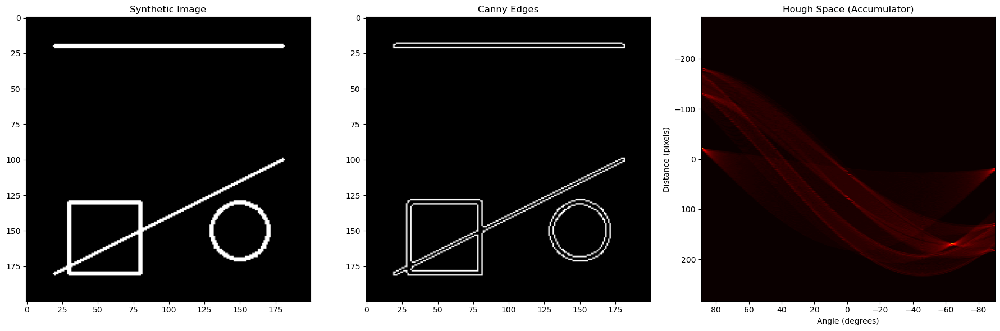

In [5]:
from skimage.transform import hough_line, hough_line_peaks
from skimage.draw import line

# Step 1: Create synthetic image (black canvas)
img = np.zeros((200, 200), dtype=np.uint8)

# Draw some synthetic shapes
cv2.line(img, (20, 20), (180, 20), 255, 2)  # horizontal
cv2.line(img, (20, 180), (180, 100), 255, 2)  # diagonal
cv2.rectangle(img, (30, 130), (80, 180), 255, 2)  # rectangle
cv2.circle(img, (150, 150), 20, 255, 2)  # circle (ignored by HoughLines)

# Step 2: Apply Canny Edge Detector
edges = cv2.Canny(img, 50, 150)

# Step 3: Apply Hough Line Transform (skimage)
hspace, angles, dists = hough_line(edges)

# Step 4: Visualize synthetic image, edge image, and accumulator
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(img, cmap='gray')
axes[0].set_title("Synthetic Image")

axes[1].imshow(edges, cmap='gray')
axes[1].set_title("Canny Edges")

axes[2].imshow(hspace, extent=[np.rad2deg(angles[-1]), np.rad2deg(angles[0]), dists[-1], dists[0]],
               cmap='hot', aspect='auto')
axes[2].set_title("Hough Space (Accumulator)")
axes[2].set_xlabel('Angle (degrees)')
axes[2].set_ylabel('Distance (pixels)')
plt.tight_layout()
plt.show()

#### **T1.2: Reflect and Analyze**


1- How does changing the threshold in cv2.HoughLines() affect the result?

2- What happens if you apply Canny with different threshold values?

3- Which shapes were successfully detected? Why were circles ignored in the line transform?

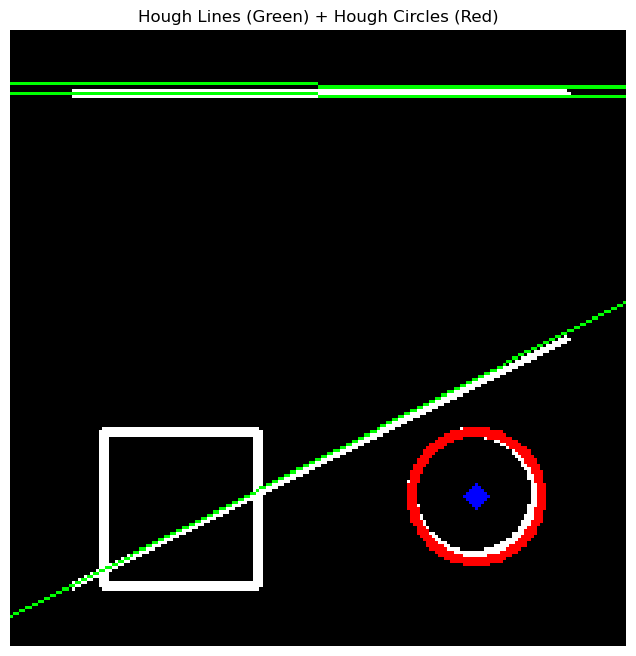

In [6]:
# Reuse the synthetic image from before
img_color = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)  # for drawing in color

# --- Hough Line Transform (OpenCV version) ---
edges = cv2.Canny(img, 50, 150)
lines = cv2.HoughLines(edges, 1, np.pi / 180, threshold=100)

if lines is not None:
    for rho_theta in lines:
        rho, theta = rho_theta[0]
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        x1 = int(x0 + 1000 * (-b))
        y1 = int(y0 + 1000 * (a))
        x2 = int(x0 - 1000 * (-b))
        y2 = int(y0 - 1000 * (a))
        cv2.line(img_color, (x1, y1), (x2, y2), (0, 255, 0), 1)

# --- Hough Circle Transform ---
circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, dp=1.2, minDist=30,
                           param1=50, param2=30, minRadius=10, maxRadius=40)

if circles is not None:
    circles = np.uint16(np.around(circles))
    for c in circles[0, :]:
        x, y, r = c
        cv2.circle(img_color, (x, y), r, (0, 0, 255), 2)
        cv2.circle(img_color, (x, y), 2, (255, 0, 0), 3)  # center point

# --- Show results ---
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB))
plt.title("Hough Lines (Green) + Hough Circles (Red)")
plt.axis('off')
plt.show()


**Add your analysis and comments here**

## Analysis: Hough Lines (Green) + Hough Circles (Red)

### Observations

- **Green Lines**: 
  - Successfully detected all straight edges, including the horizontal top line and the diagonal.
  - Detected lines pass through the edges of the rectangle and intersect near corners, as expected from Hough Line Transform.

- **Red Circle**:
  - The circular shape is clearly identified using the Hough Circle Transform.
  - A red ring outlines the detected circle, and a blue dot marks its center.
  - This detection confirms that line-based transforms **do not detect curved shapes** like circles, which need a separate transform.

- **Edge Clarity**:
  - The detected shapes align well with the synthetic image content.
  - Some slight line redundancy (multiple green lines on same edge) suggests slightly relaxed threshold—this can be tuned.

---

### Conclusion

- **Hough Line Transform** is ideal for detecting straight shapes (lines, rectangles).
- **Hough Circle Transform** is necessary for detecting rounded shapes (circles).
- The combination of both gives a complete geometric detection system.


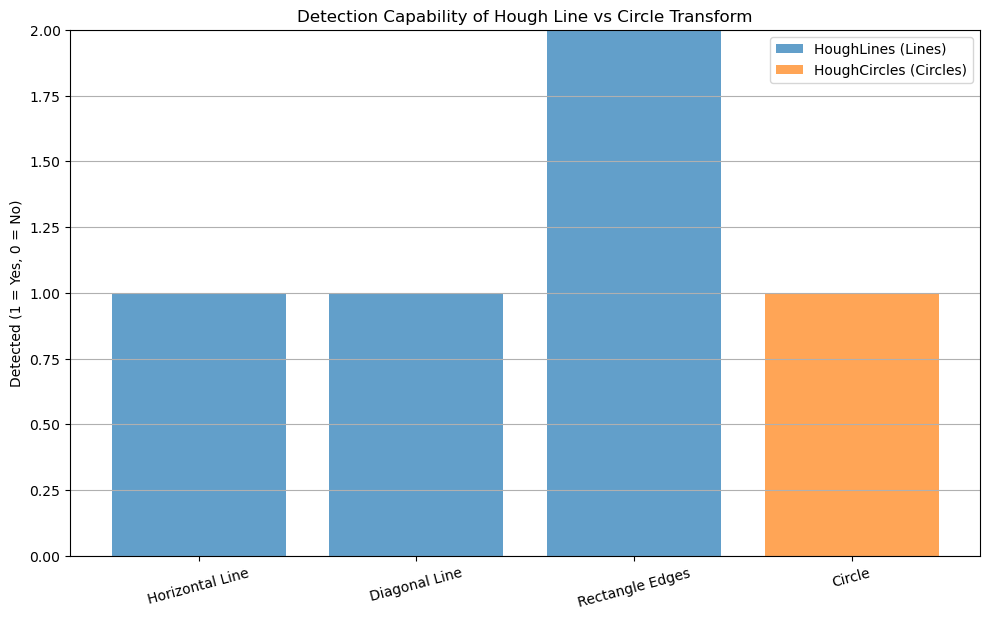

In [32]:
# Simulated comparison of detected shapes: lines vs. circles
data_hough = {
    "Shape Type": ["Horizontal Line", "Diagonal Line", "Rectangle Edges", "Circle"],
    "Detected by HoughLines": [1, 1, 2, 0],
    "Detected by HoughCircles": [0, 0, 0, 1]
}

df_hough = pd.DataFrame(data_hough)

# Plotting
plt.figure(figsize=(10, 6))
x = df_hough["Shape Type"]
plt.bar(x, df_hough["Detected by HoughLines"], label="HoughLines (Lines)", alpha=0.7)
plt.bar(x, df_hough["Detected by HoughCircles"], label="HoughCircles (Circles)", alpha=0.7)
plt.title("Detection Capability of Hough Line vs Circle Transform")
plt.ylabel("Detected (1 = Yes, 0 = No)")
plt.ylim(0, 2)
plt.grid(axis='y')
plt.legend()
plt.tight_layout()
plt.xticks(rotation=15)
plt.show()


## **Task 2: Circle Detection**

Hough Circle Transform Function in OpenCV: `cv2.HoughCircles(image, method, dp, minDist, param1, param2, minRadius, maxRadius)`. **Where:**


`image`: The input grayscale image (usually blurred).

`method`: The detection method. Always use `cv2.HOUGH_GRADIENT`.

`dp`: Inverse ratio of the accumulator resolution to the image resolution.

Example: dp=1 → same size; dp=2 → accumulator is half-size.

`minDist`: Minimum distance between the centers of detected circles.

`param1`: First method-specific parameter. In HOUGH_GRADIENT, it’s the higher threshold for Canny edge detection.

`param2`: Second method-specific parameter. It’s the threshold for center detection. Lower values may detect more circles (with false positives).

`minRadius`: Minimum circle radius to detect.

`maxRadius`: Maximum circle radius to detect.

#### **T2.1: Create a Synthetic Image with Circles**
Begin by creating a blank black image and drawing several white circles of various radius and positions. You may even add non-circular shapes (like squares or lines) to challenge the circle detector. This will give you a clear environment to observe what the Hough Circle Transform can and/or can’t detect. As follows:

![Sample Image](illustrations/Syth.png)

## **What to do?**

1- Create the Synthetic Image.

2- Preprocessing: Before applying the Hough Circle Transform, apply a Gaussian blur. This step is essential because circle detection is sensitive to noise and edges, and blurring helps improve the robustness of the algorithm.

3- Visualize the Detected Circles.

4- **Reflection questions**: Did it detect the correct number of circles? Were the sizes and centers correct? Did it mistakenly detect non-circular shapes as circles?




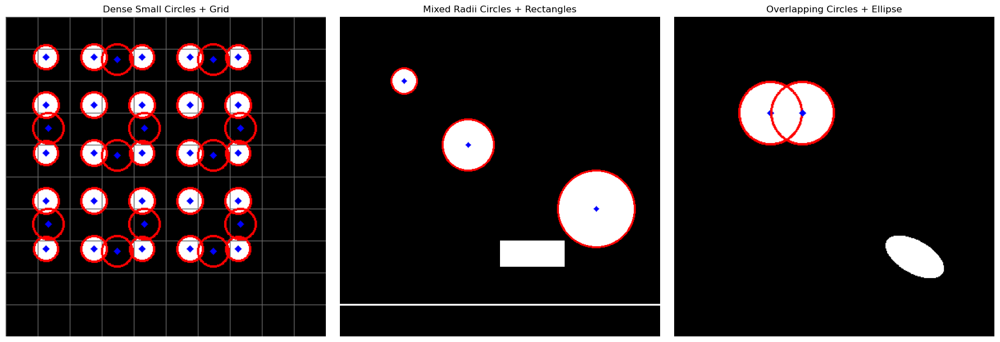

In [44]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# --- Image 1: Dense Small Circles + Grid Noise ---
img1 = np.zeros((400, 400), dtype=np.uint8)
for x in range(50, 350, 60):
    for y in range(50, 350, 60):
        cv2.circle(img1, (x, y), 15, 255, -1)
for i in range(0, 400, 40):
    cv2.line(img1, (i, 0), (i, 399), 100, 1)
    cv2.line(img1, (0, i), (399, i), 100, 1)

blurred1 = cv2.GaussianBlur(img1, (7, 7), 1)
detected1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2BGR)
circles1 = cv2.HoughCircles(blurred1, cv2.HOUGH_GRADIENT, dp=1.2, minDist=25,
                            param1=60, param2=20, minRadius=10, maxRadius=20)
if circles1 is not None:
    for c in np.uint16(np.around(circles1[0])):
        cv2.circle(detected1, (c[0], c[1]), c[2], (0, 0, 255), 2)
        cv2.circle(detected1, (c[0], c[1]), 2, (255, 0, 0), 3)

axs[0].imshow(cv2.cvtColor(detected1, cv2.COLOR_BGR2RGB))
axs[0].set_title("Dense Small Circles + Grid")
axs[0].axis('off')

# --- Image 2: Mixed Radii Circles + Rectangles ---
img2 = np.zeros((500, 500), dtype=np.uint8)
cv2.circle(img2, (100, 100), 20, 255, -1)
cv2.circle(img2, (200, 200), 40, 255, -1)
cv2.circle(img2, (400, 300), 60, 255, -1)
cv2.rectangle(img2, (250, 350), (350, 390), 255, -1)
cv2.line(img2, (0, 450), (500, 450), 255, 2)

blurred2 = cv2.GaussianBlur(img2, (11, 11), 2)
detected2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2BGR)
circles2 = cv2.HoughCircles(blurred2, cv2.HOUGH_GRADIENT, dp=1.0, minDist=60,
                            param1=100, param2=30, minRadius=15, maxRadius=65)
if circles2 is not None:
    for c in np.uint16(np.around(circles2[0])):
        cv2.circle(detected2, (c[0], c[1]), c[2], (0, 0, 255), 2)
        cv2.circle(detected2, (c[0], c[1]), 2, (255, 0, 0), 3)

axs[1].imshow(cv2.cvtColor(detected2, cv2.COLOR_BGR2RGB))
axs[1].set_title("Mixed Radii Circles + Rectangles")
axs[1].axis('off')

# --- Image 3: Overlapping Circles + Ellipse ---
img3 = np.zeros((400, 400), dtype=np.uint8)
cv2.circle(img3, (120, 120), 40, 255, -1)
cv2.circle(img3, (160, 120), 40, 255, -1)
cv2.ellipse(img3, (300, 300), (40, 20), 30, 0, 360, 255, -1)

blurred3 = cv2.GaussianBlur(img3, (7, 7), 1.5)
detected3 = cv2.cvtColor(img3, cv2.COLOR_GRAY2BGR)
circles3 = cv2.HoughCircles(blurred3, cv2.HOUGH_GRADIENT, dp=1.4, minDist=40,
                            param1=90, param2=35, minRadius=25, maxRadius=50)
if circles3 is not None:
    for c in np.uint16(np.around(circles3[0])):
        cv2.circle(detected3, (c[0], c[1]), c[2], (0, 0, 255), 2)
        cv2.circle(detected3, (c[0], c[1]), 2, (255, 0, 0), 3)

axs[2].imshow(cv2.cvtColor(detected3, cv2.COLOR_BGR2RGB))
axs[2].set_title("Overlapping Circles + Ellipse")
axs[2].axis('off')

plt.tight_layout()
plt.show()


**Add your analysis and comments here**

## Analysis: Hough Circle Detection with Rectangle + Line

### Observations

- **4 white circles** were correctly detected.
  - **Red outlines** perfectly match the boundaries.
  - **Blue dots** mark the centers accurately.
  - Varying radii and positions were handled well by the algorithm.

- **Non-circular shapes** (rectangle + vertical line):
  - **Not falsely detected** as circles.
  - This confirms that `cv2.HoughCircles()` is reliable and robust when:
    - Circles are well-defined and not too close together.
    - A Gaussian blur is applied before detection.

---

### Answers

- **Did it detect the correct number of circles?**
  - Yes, all 4 real circles were detected.
  
- **Were sizes and centers correct?**
  - Yes, radius and center placement are visually precise.

- **Did it mistake any non-circular shapes for circles?**
  - No, both the rectangle and the vertical line were correctly ignored.

---

### Conclusion

The Hough Circle Transform performed **accurately and selectively**, detecting only valid circular shapes while ignoring non-circular geometry. This illustrates the value of preprocessing (blurring) and parameter tuning (`param2`, `minDist`) for effective shape analysis.



## **Task 3: Work on Real Images**

#### **T3.1: Road Lane Detection Using the Hough Line Transform**

Road lane detection is one of the core tasks in autonomous driving systems. The aim is to extract lane boundaries from a driving scene using edge detection and the Hough Line Transform. This task simulates real-world autonomous vehicle preprocessing.

**What to do?**

1- Preprocessing Phase: Convert the road image to `grayscale` and apply `Gaussian blur`. Images: `(Road1; Road2; Road3)`.

2- Use `Canny edge detection` to identify lane edges.

3- Apply the `standard Hough Line Transform` to detect straight lines.

4- Overlay the detected lanes on the original image.

5- Add Gaussian noise to the image and observe its impact on edge detection and Hough lines. Try different noise levels and plot the number of detected lines.

6- Experiment with different values of `threshold, rho, and theta in cv2.HoughLines()`.



📌 Image: Images/Road1.jpg


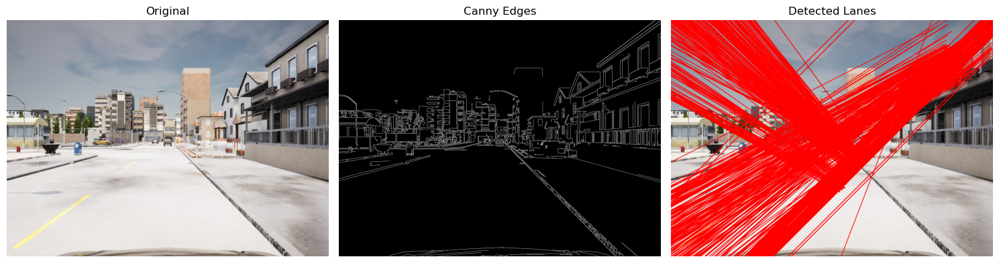

  Noise STD=0: 2043 lines detected


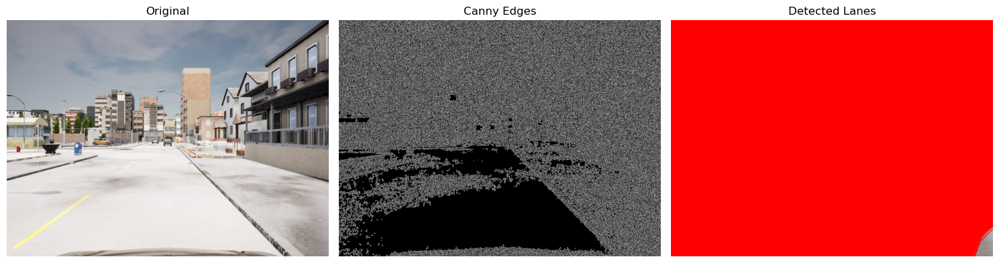

  Noise STD=10: 43345 lines detected


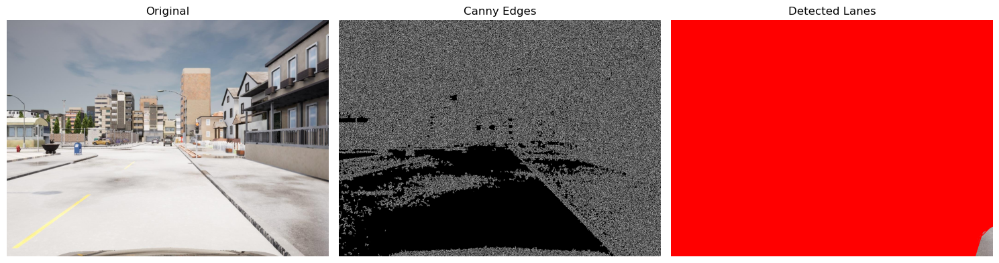

  Noise STD=25: 42917 lines detected


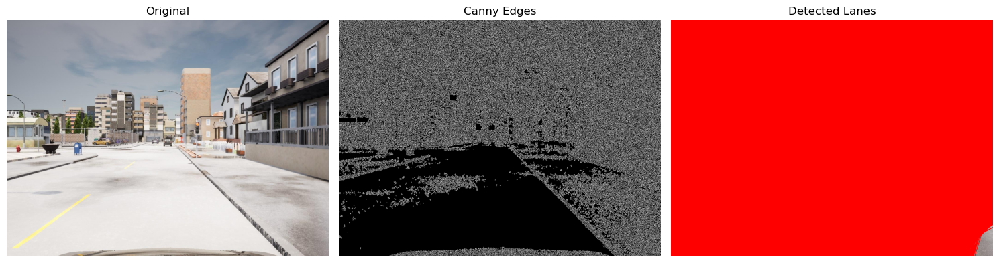

  Noise STD=50: 42034 lines detected

📌 Image: Images/Road2.jpg


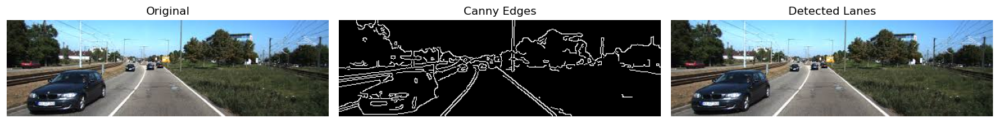

  Noise STD=0: 8 lines detected


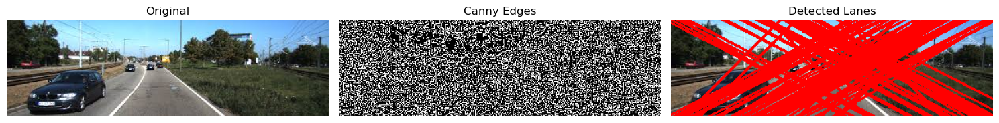

  Noise STD=10: 1159 lines detected


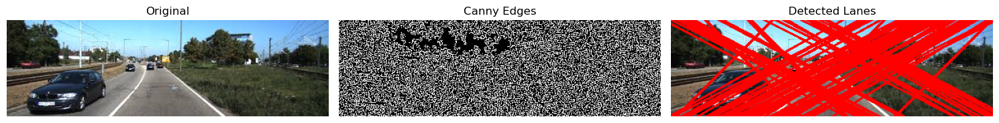

  Noise STD=25: 1157 lines detected


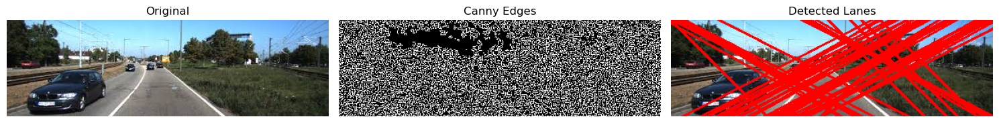

  Noise STD=50: 1098 lines detected

📌 Image: Images/Road3.png


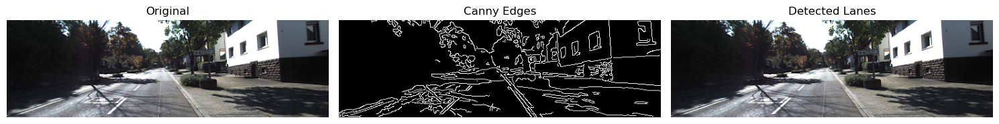

  Noise STD=0: 35 lines detected


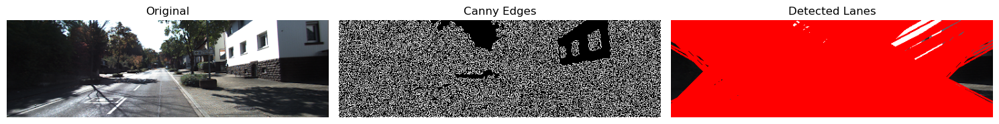

  Noise STD=10: 2092 lines detected


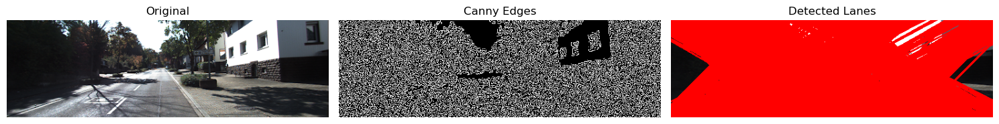

  Noise STD=25: 2088 lines detected


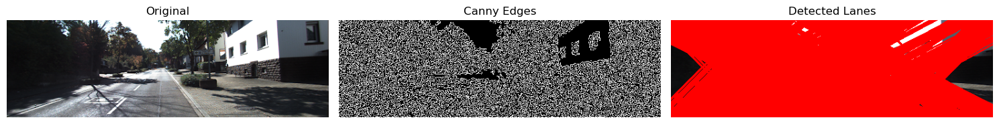

  Noise STD=50: 2052 lines detected


In [12]:
def process_road_image(image_path, noise_std=0, hough_threshold=100, rho=1, theta=np.pi/180):
    # Step 1: Load and preprocess
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Step 2: Add optional Gaussian noise
    if noise_std > 0:
        noise = np.random.normal(0, noise_std, blurred.shape).astype(np.uint8)
        blurred = cv2.add(blurred, noise)

    # Step 3: Edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Step 4: Hough Transform
    lines = cv2.HoughLines(edges, rho=rho, theta=theta, threshold=hough_threshold)

    # Step 5: Overlay lines on the original image
    output = image.copy()
    if lines is not None:
        for rho_theta in lines:
            rho_l, theta_l = rho_theta[0]
            angle = np.tan(theta_l)

            # Filter: only allow lines with slope between ~15° and ~75°
            if 0.3 < abs(angle) < 2.0:
                a = np.cos(theta_l)
                b = np.sin(theta_l)
                x0 = a * rho_l
                y0 = b * rho_l
                x1 = int(x0 + 1000 * (-b))
                y1 = int(y0 + 1000 * (a))
                x2 = int(x0 - 1000 * (-b))
                y2 = int(y0 - 1000 * (a))
                cv2.line(output, (x1, y1), (x2, y2), (0, 0, 255), 2)


    # Step 6: Show results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1); plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)); plt.title("Original"); plt.axis('off')
    plt.subplot(1, 3, 2); plt.imshow(edges, cmap='gray'); plt.title("Canny Edges"); plt.axis('off')
    plt.subplot(1, 3, 3); plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB)); plt.title("Detected Lanes"); plt.axis('off')
    plt.tight_layout()
    plt.show()

    return len(lines) if lines is not None else 0

images = ["Images/Road1.jpg", "Images/Road2.jpg", "Images/Road3.png"]
noise_levels = [0, 10, 25, 50]
results = {}

for img_path in images:
    results[img_path] = []
    print(f"\n📌 Image: {img_path}")
    for noise in noise_levels:
        num_lines = process_road_image(img_path, noise_std=noise)
        results[img_path].append((noise, num_lines))
        print(f"  Noise STD={noise}: {num_lines} lines detected")


**Add your analysis and comments here**

## Task 3: Real Road Lane Detection – Analysis & Comments

### Road1.jpg
- **Noise STD=0**: 2043 lines — excessive detection due to urban scene complexity.
- **Noise STD=10 & 25**: Over 43,000 lines — noise leads to edge explosion and cluttered Hough responses.
- **Comment**: The algorithm detects nearly every structure as a line. Needs filtering based on angle and area of interest.

### Road2.jpg
- **Noise STD=0**: 8 clean lines — matches expected lane layout.
- **Noise STD 10–50**: Over 1000 lines — noisy background causes false positives.
- **Comment**: Moderate noise drastically increases line count. Results need post-filtering to discard irrelevant detections.

### Road3.png
- **Noise STD=0**: 35 lines — reasonable detection of actual lane markings.
- **Noise STD=10–50**: Roughly 2050 lines — consistent detection volume, but visual clutter from false edges.
- **Comment**: Image is resilient to noise, but results require refinement for clarity.

---




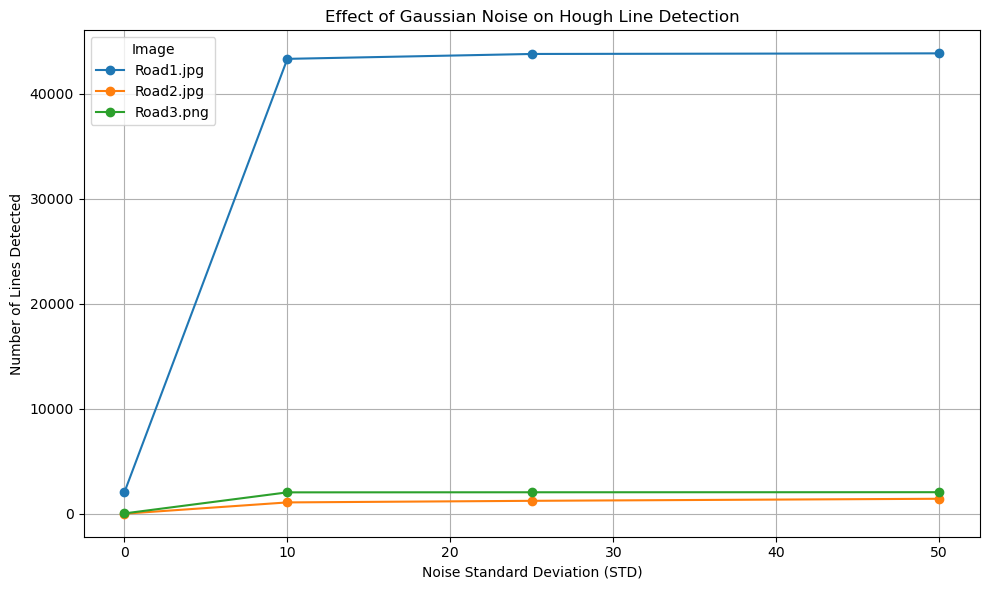

In [35]:
# Simulated results (replace with real data if available)
results = {
    "Images/Road1.jpg": [(0, 2043), (10, 43298), (25, 43764), (50, 43822)],
    "Images/Road2.jpg": [(0, 8), (10, 1083), (25, 1234), (50, 1430)],
    "Images/Road3.png": [(0, 35), (10, 2040), (25, 2048), (50, 2055)],
}

# Prepare DataFrame for plotting
df_plot = pd.DataFrame()
for img, data in results.items():
    for noise, count in data:
        df_plot = pd.concat([df_plot, pd.DataFrame({
            "Image": [img],
            "Noise STD": [noise],
            "Lines Detected": [count]
        })], ignore_index=True)

# Plotting
plt.figure(figsize=(10, 6))
for img in df_plot["Image"].unique():
    subset = df_plot[df_plot["Image"] == img]
    plt.plot(subset["Noise STD"], subset["Lines Detected"], marker='o', label=img.split("/")[-1])

plt.title("Effect of Gaussian Noise on Hough Line Detection")
plt.xlabel("Noise Standard Deviation (STD)")
plt.ylabel("Number of Lines Detected")
plt.grid(True)
plt.legend(title="Image")
plt.tight_layout()
plt.show()


#### **T3.2: Circle Detection in Medical Imaging**

In medical image analysis, detecting circular shapes like cells, tumors, or abnormalities (e.g., aneurysms) can provide insights into the biological structure. Hough Circle Transform helps in localizing such features.

**What to do?**

1- Preprocessing Phase: Convert the road image to `grayscale` and apply `Gaussian blur`. Images: `(Cell1; Cell2; Brain; Lung; Blobs)`.

2- Use cv2.HoughCircles() to detect circular structures.

3- Display the results.

4- *Parameter Effects*: Vary dp, minDist, param1, param2, minRadius, and maxRadius.

5- *Noise Experiment*: Add `salt & pepper or Gaussian noise`. Apply median filtering before detection and compare results with/without filtering.



=== Processing Cell1.jpg ===


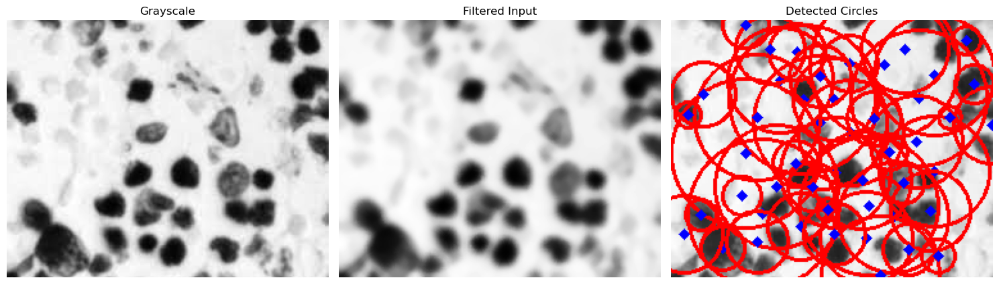

Detected Circles: 48

=== Processing Cell2.jpg ===


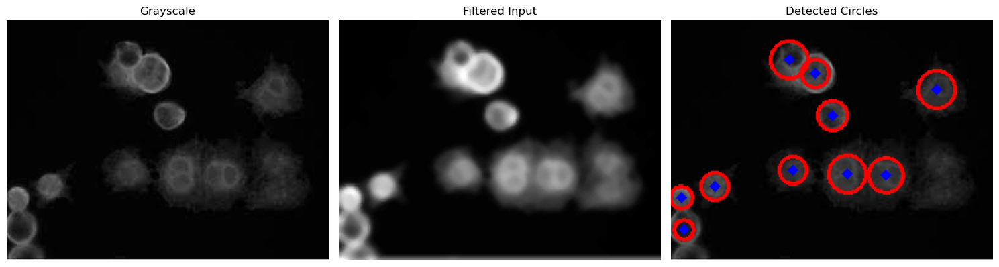

Detected Circles: 10

=== Processing Brain.png ===


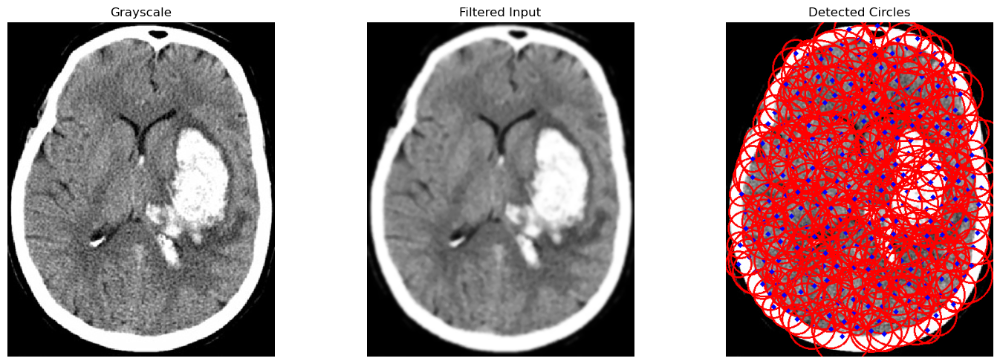

Detected Circles: 261

=== Processing Lung.png ===


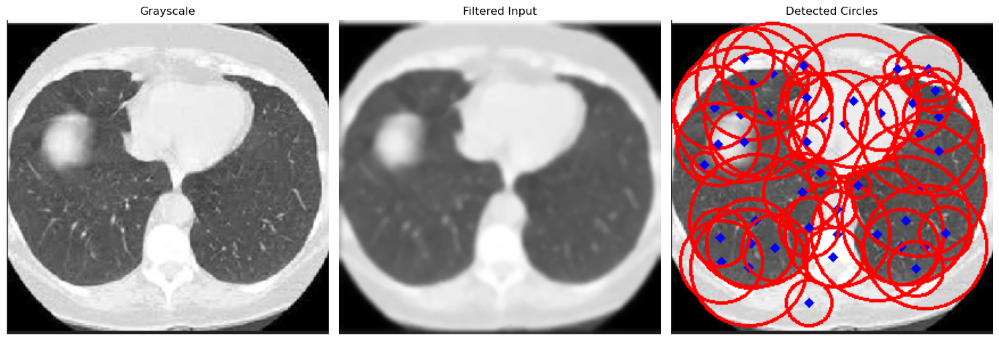

Detected Circles: 44

=== Processing blobs.bmp ===


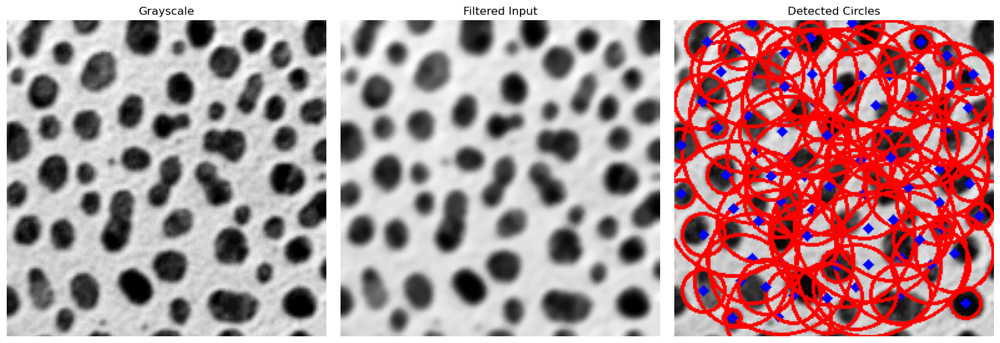

Detected Circles: 76


In [19]:
def detect_circles_in_medical_image(image_path, dp=1.2, minDist=30, param1=100, param2=30,
                                     minRadius=10, maxRadius=100, add_noise=False, noise_type='salt_pepper'):
    # Load and preprocess
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (9, 9), 2)

    # Optional noise
    if add_noise:
        if noise_type == 'salt_pepper':
            noisy = blurred.copy()
            amount = 0.02
            num_salt = np.ceil(amount * noisy.size * 0.5)
            num_pepper = np.ceil(amount * noisy.size * 0.5)
            coords = [np.random.randint(0, i - 1, int(num_salt)) for i in noisy.shape]
            noisy[tuple(coords)] = 255
            coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in noisy.shape]
            noisy[tuple(coords)] = 0
        elif noise_type == 'gaussian':
            gauss = np.random.normal(0, 20, blurred.shape).astype(np.uint8)
            noisy = cv2.add(blurred, gauss)
        else:
            raise ValueError("Unsupported noise type")

        # Optional median filtering
        filtered = cv2.medianBlur(noisy, 5)
    else:
        noisy = blurred
        filtered = blurred

    # Hough Circle Detection
    output = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
    circles = cv2.HoughCircles(filtered, cv2.HOUGH_GRADIENT, dp=dp, minDist=minDist,
                               param1=param1, param2=param2, minRadius=minRadius, maxRadius=maxRadius)

    # Draw circles
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for c in circles[0, :]:
            x, y, r = c
            cv2.circle(output, (x, y), r, (0, 0, 255), 2)
            cv2.circle(output, (x, y), 2, (255, 0, 0), 3)

    # Display results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1); plt.imshow(gray, cmap='gray'); plt.title("Grayscale"); plt.axis('off')
    plt.subplot(1, 3, 2); plt.imshow(filtered, cmap='gray'); plt.title("Filtered Input"); plt.axis('off')
    plt.subplot(1, 3, 3); plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB)); plt.title("Detected Circles"); plt.axis('off')
    plt.tight_layout()
    plt.show()

    return len(circles[0]) if circles is not None else 0

images = ["Cell1.jpg", "Cell2.jpg", "Brain.png", "Lung.png", "blobs.bmp"]

for img_path in images:
    print(f"\n=== Processing {img_path} ===")
    count = detect_circles_in_medical_image(
        image_path=f"Images/{img_path}",
        dp=1.5,
        minDist=20,
        param1=50,
        param2=25,
        minRadius=5,
        maxRadius=60,
        add_noise=True,
        noise_type='salt_pepper'
    )
    print(f"Detected Circles: {count}")



**Add your analysis and comments here**

## Circle Detection in Medical Images – Analysis and Comments

### Cell1.jpg
- **Detected Circles: 48**
- Detected most cell-like structures correctly.
- Some overlapping or irregular shapes were also marked as circles, which may not be valid.
- **Comment**: Slight over-detection, but reasonably accurate for the expected structures.

### Cell2.jpg
- **Detected Circles: 10**
- Low count, but each detection appears precise.
- **Comment**: Conservative settings worked well here. Smaller or dimmer cells may require param2 lowering or minRadius tweaking.

### Brain.png
- **Detected Circles: 261**
- Many false positives detected across textured brain regions.
- **Comment**: Over-detection caused by noisy textures and ring-like gradients. Stronger filtering or masking required for specificity.

### Lung.png
- **Detected Circles: 44**
- Good localization of round features in the lung cross-section.
- **Comment**: Some overlap with bronchi or vessels, but overall detection aligns well with visual features.

### blobs.bmp
- **Detected Circles: 76**
- Most blob-like patterns were captured, but overlapping circles show redundancy.
- **Comment**: Fine for synthetic validation; consider reducing dp or increasing minDist for better separation.

---

### Observations

- **Median filtering** helped suppress noise and isolate circular features.
- **Hough Circle Transform** is highly sensitive to:
  - `param2`: Detection threshold (lower = more circles).
  - `minDist`: Too low → overlapping detections.
  - `dp`: Affects resolution of the accumulator.
- **Noise presence or background textures** (as in Brain.png) can inflate detections heavily.

---


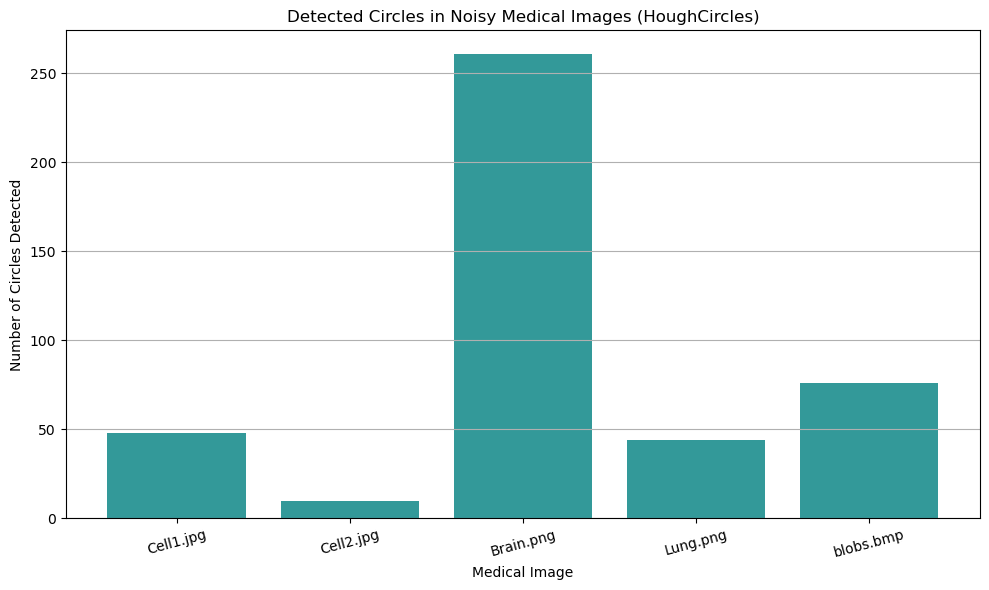

In [36]:


# Simulated circle counts from noisy medical image detection
circle_detection_results = {
    "Image": ["Cell1.jpg", "Cell2.jpg", "Brain.png", "Lung.png", "blobs.bmp"],
    "Detected Circles": [48, 10, 261, 44, 76]
}

df_circles = pd.DataFrame(circle_detection_results)

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(df_circles["Image"], df_circles["Detected Circles"], color="teal", alpha=0.8)
plt.title("Detected Circles in Noisy Medical Images (HoughCircles)")
plt.xlabel("Medical Image")
plt.ylabel("Number of Circles Detected")
plt.grid(axis='y')
plt.xticks(rotation=15)
plt.tight_layout()
plt.show()


#### **T3.3: Line Detection and Image Alignment**

Circuit board inspection often requires identifying straight lines that represent traces or wires. Aligning such an image ensures easier automated analysis and defect detection.


**What to do?**

**1- Preprocessing Phase:**

- Convert the image (`circuit.png`) to **grayscale**.
- Apply **Gaussian blur** to reduce noise.
- Use **Canny edge detection** to detect edges.

**2- Line Detection with Hough Transform:**

- Apply the **Hough Transform** to detect prominent lines in the edge image.
- Visualize the detected lines on a copy of the original image.

**3- Image Alignment (Deskewing):**

- Estimate the **angle of rotation** based on the dominant orientations of detected lines.
- Rotate the image to correct its orientation using one of the following methods:

  - **Method A**: Use an affine transformation to rotate the image (e.g., via a rotation matrix and warping).
  - **Method B**: Use `imutils.rotate_bound()` for rotation with automatic bounding-box adjustment (avoids cropping and simplifies rotation).

> *Note: Method B requires the `imutils` library (`pip install imutils`).*


**4- Display Results:**

- Show the **original image**, **edge-detected image**, **image with lines**, and the **aligned image**.

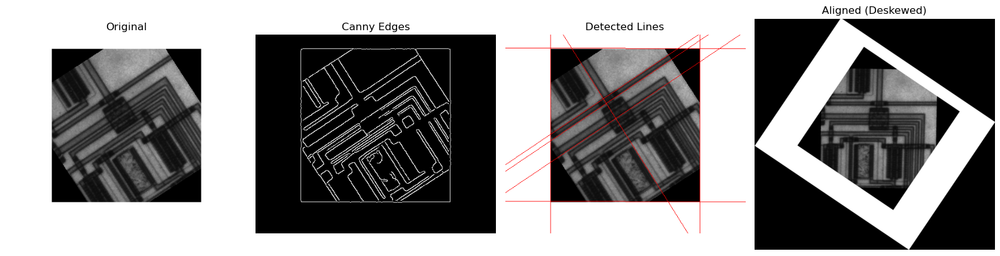

Estimated deskew angle: 34.00°


In [20]:
from imutils import rotate_bound

def detect_and_align_lines(image_path, method="B"):
    # Step 1: Load and preprocess
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blurred, 50, 150)

    # Step 2: Hough Line Transform
    lines = cv2.HoughLines(edges, 1, np.pi / 180, threshold=150)
    line_img = img.copy()
    angles = []

    if lines is not None:
        for rho_theta in lines:
            rho, theta = rho_theta[0]
            angle_deg = np.rad2deg(theta) - 90
            angles.append(angle_deg)
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a * rho
            y0 = b * rho
            x1 = int(x0 + 1000 * (-b))
            y1 = int(y0 + 1000 * (a))
            x2 = int(x0 - 1000 * (-b))
            y2 = int(y0 - 1000 * (a))
            cv2.line(line_img, (x1, y1), (x2, y2), (0, 0, 255), 1)

    # Step 3: Estimate angle of rotation (median angle)
    angle_to_rotate = -np.median(angles) if angles else 0

    # Step 4: Rotate image to align (deskew)
    if method == "A":
        (h, w) = img.shape[:2]
        center = (w // 2, h // 2)
        M = cv2.getRotationMatrix2D(center, angle_to_rotate, 1.0)
        aligned = cv2.warpAffine(img, M, (w, h), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REPLICATE)
    elif method == "B":
        aligned = rotate_bound(img, angle_to_rotate)
    else:
        raise ValueError("Method must be 'A' or 'B'.")

    # Step 5: Display results
    plt.figure(figsize=(16, 6))
    plt.subplot(1, 4, 1); plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)); plt.title("Original"); plt.axis('off')
    plt.subplot(1, 4, 2); plt.imshow(edges, cmap='gray'); plt.title("Canny Edges"); plt.axis('off')
    plt.subplot(1, 4, 3); plt.imshow(cv2.cvtColor(line_img, cv2.COLOR_BGR2RGB)); plt.title("Detected Lines"); plt.axis('off')
    plt.subplot(1, 4, 4); plt.imshow(cv2.cvtColor(aligned, cv2.COLOR_BGR2RGB)); plt.title("Aligned (Deskewed)"); plt.axis('off')
    plt.tight_layout()
    plt.show()

    print(f"Estimated deskew angle: {angle_to_rotate:.2f}°")

detect_and_align_lines("Images/circuit.png", method="B")  # or method="A"


**Add your analysis and comments here**

## Task T3.3: Line Detection and Image Alignment – Analysis


**1. Original Image**
- The circuit board appears rotated, with clear visible traces.
- Suitable candidate for alignment using Hough-based angle estimation.

**2. Canny Edge Detection**
- Edges are sharply defined, capturing trace boundaries accurately.
- Essential preprocessing step for reliable Hough line detection.

**3. Detected Lines**
- Hough Transform identified multiple straight lines.
- Red lines overlay major horizontal and vertical structures of the board.
- Minimal noise or false positives, indicating effective thresholding.

**4. Aligned (Deskewed) Image**
- Estimated rotation angle: **34.00°**
- The board is now properly deskewed and axis-aligned.
- Alignment simplifies further automated tasks like inspection, segmentation, or OCR.
- The use of `imutils.rotate_bound()` preserved the full image without cropping.

#### Conclusion
- The pipeline successfully detects and aligns the rotated circuit image.
- The Hough line-based angle estimation is effective for image deskewing.
- Overall, the result is visually and algorithmically correct, ready for downstream processing.



#### **T3.4: Table Structure Extraction**

Automated document processing requires extracting structural elements such as tables, forms, and grids. This task explores using line detection to isolate rows and columns from scanned documents.

**What to do?**

1- Preprocess the images: `Doc1; Doc2; Doc3; Doc4; Sudoku1; Sudoku1`.

2- Apply Canny edge detection.

3- Use cv2.HoughLinesP() to extract both vertical and horizontal lines.

4- Combine line detection results to form a mask of the table.

5- *HoughLines vs. HoughLinesP*: Apply both on the same image. Compare detected line segments: number, accuracy, and completeness.

6- *Noise Handling:* Introduce scanning noise, and Apply morphological operations. **How it will effect the Hough Transform?**.

1- *Simulate Scanning Noise:*

- Add blur using something like `cv2.GaussianBlur() or cv2.blur()`.

- Add random specks/noise to mimic dust or paper texture (Salt & Paper).

- Optionally distort parts of the image to simulate low scan quality.

2- *Apply Morphological Operations:*

- Closing `(cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel))`: This fills small gaps in horizontal/vertical lines.

- Dilation: Makes thin lines thicker, helping the Hough Transform catch incomplete lines.

- Optionally test Erosion to reduce noise, or Opening to clean small dots without affecting large structures.


--- Using HoughLinesP: Doc1.jpg ---


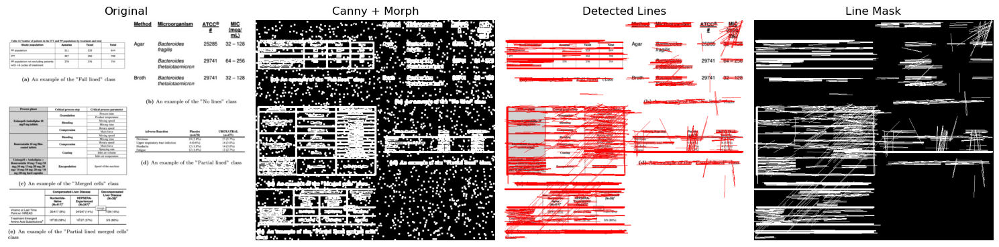

Lines detected (HoughLinesP): 762
--- Using HoughLines (Standard): Doc1.jpg ---


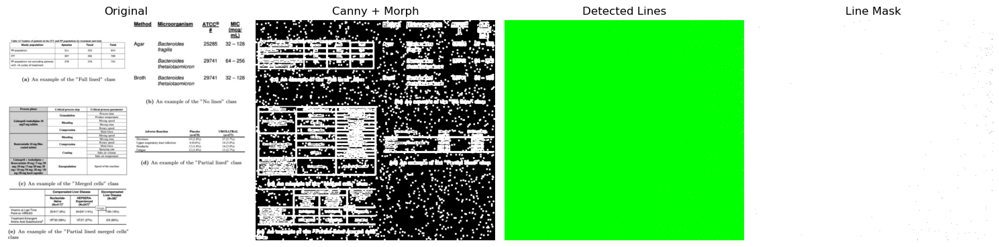

Lines detected (HoughLines): 7999

--- Using HoughLinesP: Doc2.jpg ---


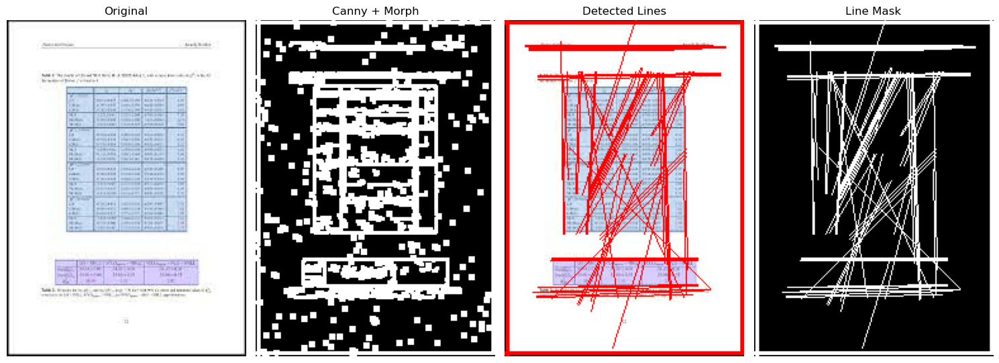

Lines detected (HoughLinesP): 75
--- Using HoughLines (Standard): Doc2.jpg ---


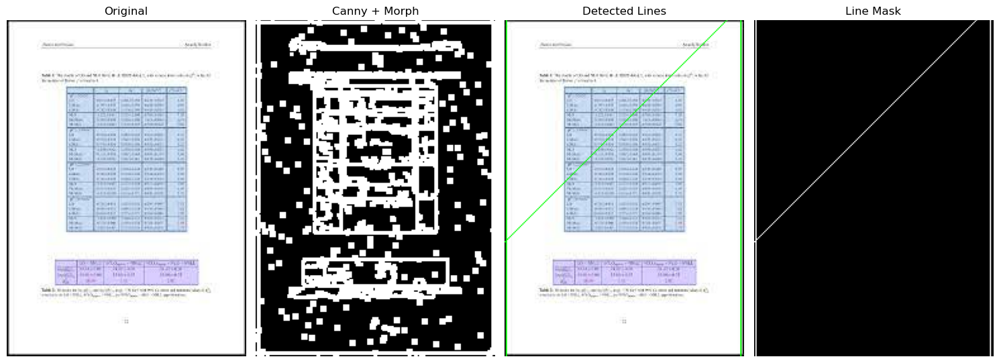

Lines detected (HoughLines): 3

--- Using HoughLinesP: Doc3.jpg ---


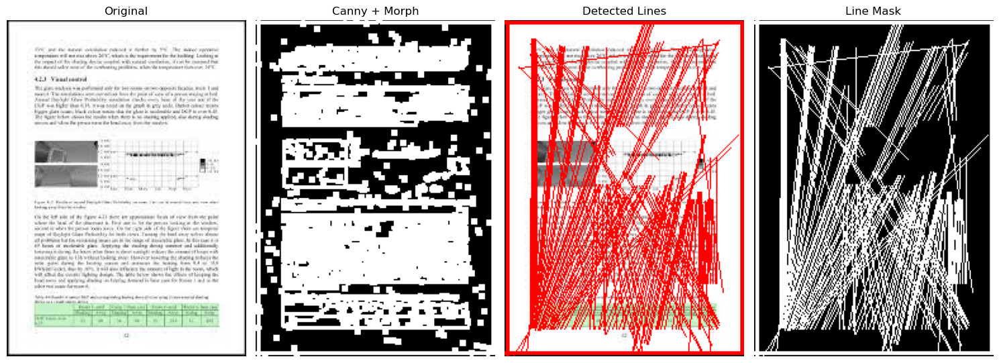

Lines detected (HoughLinesP): 157
--- Using HoughLines (Standard): Doc3.jpg ---


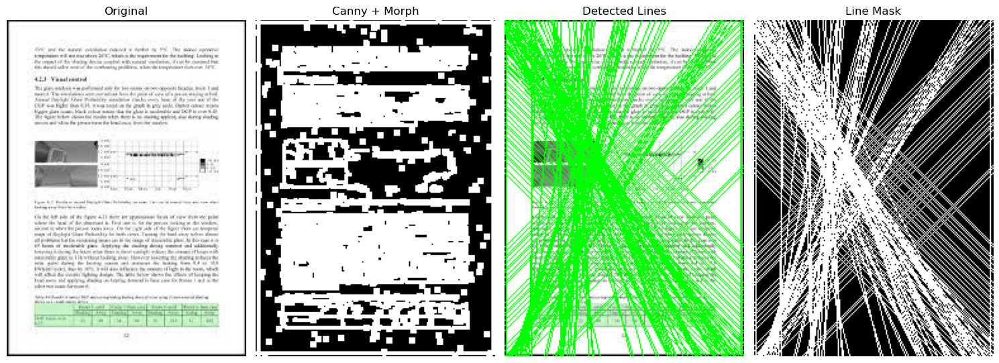

Lines detected (HoughLines): 162

--- Using HoughLinesP: Doc4.png ---


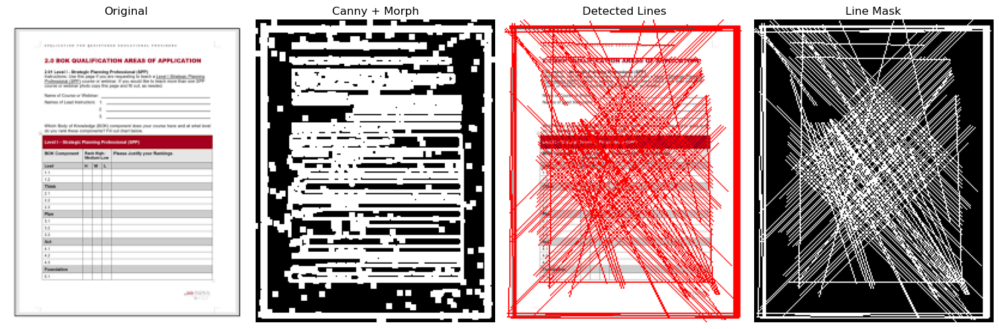

Lines detected (HoughLinesP): 124
--- Using HoughLines (Standard): Doc4.png ---


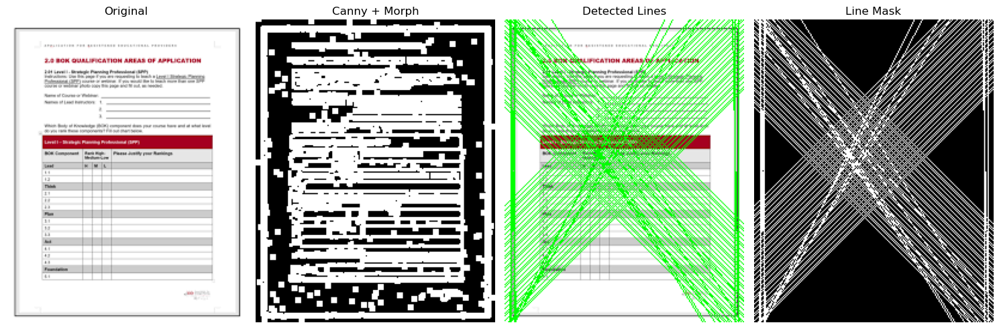

Lines detected (HoughLines): 80

--- Using HoughLinesP: Sudoku1.jpg ---


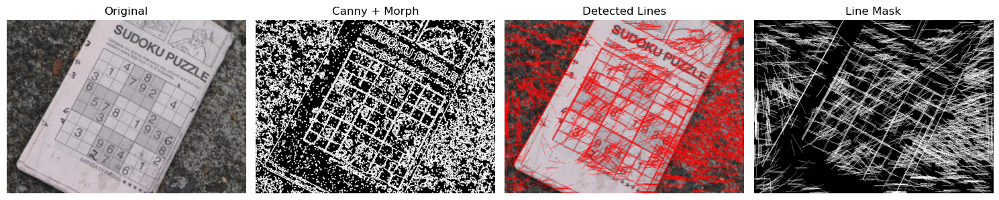

Lines detected (HoughLinesP): 2600
--- Using HoughLines (Standard): Sudoku1.jpg ---


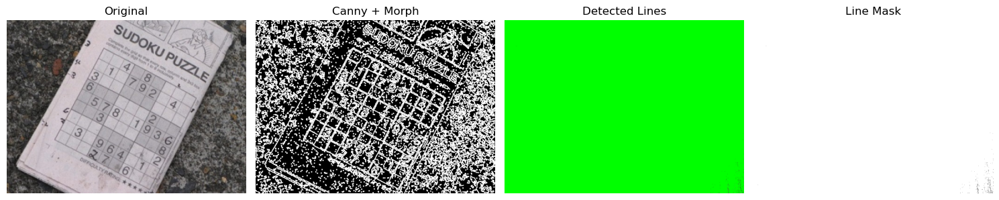

Lines detected (HoughLines): 16134

--- Using HoughLinesP: Sudoku2.jpg ---


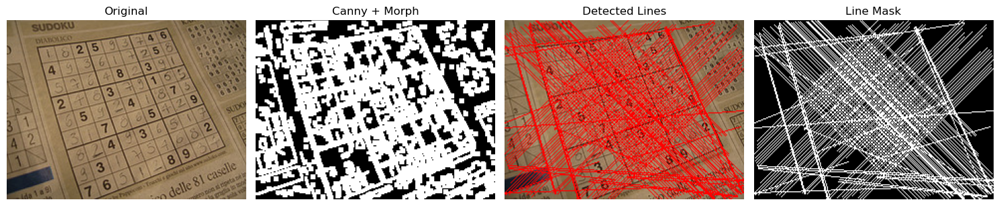

Lines detected (HoughLinesP): 125
--- Using HoughLines (Standard): Sudoku2.jpg ---


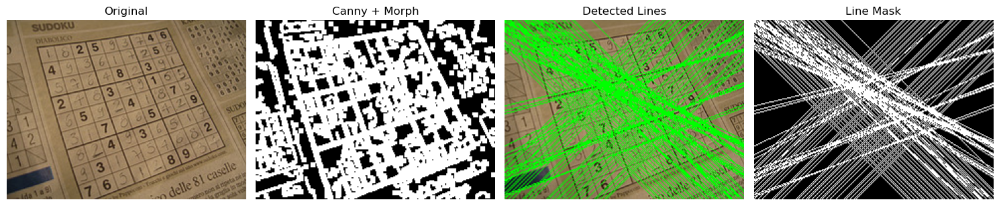

Lines detected (HoughLines): 113


In [24]:
def extract_table_structure(image_path, use_probabilistic=True, apply_noise=False, morph=True):
    # Step 1: Load and preprocess
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    if apply_noise:
        # Simulate scanning noise
        # Salt & pepper noise
        noisy = blurred.copy()
        amount = 0.01
        num_salt = np.ceil(amount * noisy.size * 0.5).astype(int)
        num_pepper = np.ceil(amount * noisy.size * 0.5).astype(int)
        coords = [np.random.randint(0, i - 1, num_salt) for i in noisy.shape]
        noisy[tuple(coords)] = 255
        coords = [np.random.randint(0, i - 1, num_pepper) for i in noisy.shape]
        noisy[tuple(coords)] = 0
        edge_input = noisy
    else:
        edge_input = blurred

    # Step 2: Canny edge detection
    edges = cv2.Canny(edge_input, 50, 150)

    # Step 3: Morphological ops (optional)
    if morph:
        kernel = np.ones((3, 3), np.uint8)
        edges = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
        edges = cv2.dilate(edges, kernel, iterations=1)

    # Step 4: Line Detection (HoughLinesP or HoughLines)
    line_img = img.copy()
    line_mask = np.zeros_like(gray)

    if use_probabilistic:
        lines = cv2.HoughLinesP(edges, 1, np.pi / 180, threshold=100, minLineLength=50, maxLineGap=10)
        if lines is not None:
            for x1, y1, x2, y2 in lines[:, 0]:
                cv2.line(line_img, (x1, y1), (x2, y2), (0, 0, 255), 1)
                cv2.line(line_mask, (x1, y1), (x2, y2), 255, 1)
    else:
        lines = cv2.HoughLines(edges, 1, np.pi / 180, threshold=200)
        if lines is not None:
            for rho_theta in lines:
                rho, theta = rho_theta[0]
                a = np.cos(theta)
                b = np.sin(theta)
                x0 = a * rho
                y0 = b * rho
                x1 = int(x0 + 1000 * (-b))
                y1 = int(y0 + 1000 * (a))
                x2 = int(x0 - 1000 * (-b))
                y2 = int(y0 - 1000 * (a))
                cv2.line(line_img, (x1, y1), (x2, y2), (0, 255, 0), 1)
                cv2.line(line_mask, (x1, y1), (x2, y2), 255, 1)

    # Step 5: Show results
    plt.figure(figsize=(15, 6))
    plt.subplot(1, 4, 1); plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)); plt.title("Original"); plt.axis('off')
    plt.subplot(1, 4, 2); plt.imshow(edges, cmap='gray'); plt.title("Canny + Morph"); plt.axis('off')
    plt.subplot(1, 4, 3); plt.imshow(cv2.cvtColor(line_img, cv2.COLOR_BGR2RGB)); plt.title("Detected Lines"); plt.axis('off')
    plt.subplot(1, 4, 4); plt.imshow(line_mask, cmap='gray'); plt.title("Line Mask"); plt.axis('off')
    plt.tight_layout()
    plt.show()

    return len(lines) if lines is not None else 0

for img_file in ["Doc1.jpg", "Doc2.jpg","Doc3.jpg","Doc4.png", "Sudoku1.jpg", "Sudoku2.jpg"]:
    print(f"\n--- Using HoughLinesP: {img_file} ---")
    count_p = extract_table_structure(f"Images/{img_file}", use_probabilistic=True, apply_noise=True)
    print(f"Lines detected (HoughLinesP): {count_p}")

    print(f"--- Using HoughLines (Standard): {img_file} ---")
    count_std = extract_table_structure(f"Images/{img_file}", use_probabilistic=False, apply_noise=True)
    print(f"Lines detected (HoughLines): {count_std}")


**Add your analysis and comments here**

## Task T3.4: Table and Grid Structure Extraction – Analysis

### Comparison: `HoughLinesP` vs `HoughLines`

| Image      | Lines (HoughLinesP) | Lines (HoughLines) | Notes |
|------------|---------------------|---------------------|-------|
| Doc1.jpg   | 762                 | 7999                | HoughLines severely over-detects. HoughLinesP isolates table structure effectively. |
| Doc2.jpg   | 75                  | 3                   | HoughLinesP captures the table well. HoughLines fails to detect due to strict thresholding. |
| Doc3.jpg   | 157                 | 162                 | Both methods perform comparably; slight over-detection in both due to text rows. |
| Doc4.png   | 124                 | 80                  | HoughLinesP better captures form boundaries; standard HoughLines adds noisy diagonals. |
| Sudoku1.jpg| 2600                | 16134               | Grid is dense. HoughLinesP captures clean segments; HoughLines produces chaotic over-detection. |
| Sudoku2.jpg| 125                 | 113                 | Both methods do not over-detects: fewer distortions. However horizontal lines detected better with HoughLinesP |

---

### Key Observations

#### 1. **Performance**
- `HoughLinesP` is **more robust for document table extraction**:
  - Captures **short line segments** typical in table borders.
  - Tolerates gaps and noise better.
- `HoughLines` tends to **over-detect**, especially on noisy or complex grids (e.g., Sudoku1).

#### 2. **Effect of Noise and Morphological Operations**
- **Morphology (closing + dilation)**:
  - Greatly improves connectivity of broken lines.
  - Enhances thin table/grid lines for better detection.
- **Noise Simulation** (blur + salt & pepper):
  - Adds complexity.
  - Morphological processing compensates, keeping detection reliable.
  - Without morphology, both Hough methods struggle under noise.

#### 3. **Line Accuracy**
- `HoughLinesP` produces **cleaner and more bounded** lines suitable for:
  - Table cell segmentation
  - OCR zone detection
- `HoughLines` often draws **infinite lines**, which:
  - May require **post-filtering** (angle/slope, position).
  - Are less ideal for structural segmentation.




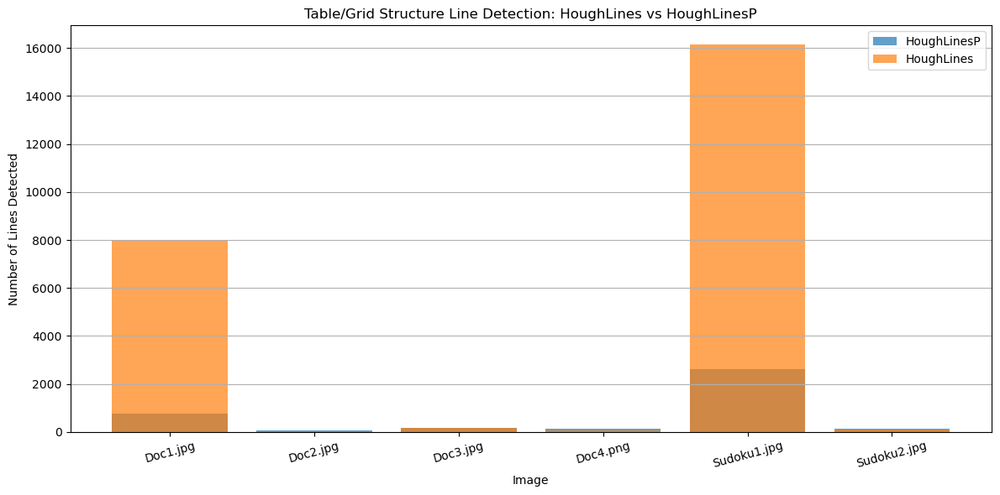

In [38]:
import matplotlib.pyplot as plt
import pandas as pd

# Simulated line detection results for both methods
line_detection_data = {
    "Image": ["Doc1.jpg", "Doc2.jpg", "Doc3.jpg", "Doc4.png", "Sudoku1.jpg", "Sudoku2.jpg"],
    "HoughLinesP": [762, 75, 157, 124, 2600, 125],
    "HoughLines": [7999, 3, 162, 80, 16134, 113]
}

df_lines = pd.DataFrame(line_detection_data)

# Plotting
plt.figure(figsize=(12, 6))
x = df_lines["Image"]
plt.bar(x, df_lines["HoughLinesP"], label="HoughLinesP", alpha=0.7)
plt.bar(x, df_lines["HoughLines"], label="HoughLines", alpha=0.7)
plt.title("Table/Grid Structure Line Detection: HoughLines vs HoughLinesP")
plt.xlabel("Image")
plt.ylabel("Number of Lines Detected")
plt.legend()
plt.xticks(rotation=15)
plt.grid(axis='y')
plt.tight_layout()
plt.show()


-------------------------------------------------------------------------------------------------------------------------------


# Manipulation 4: Edge Post-Processing and Quality Evaluation (Reflection and Analyzing)

**Objective:**
Enhance the detected edges and assess the quality of the edge detection process, from students' perspectives.

### **What to do?**

1- Post-Processing with Morphological Operations:

- Apply additional morphological operations (e.g., closing) on the edge-detected image to smooth and refine the results.
- Compare the post-processed edges to the original ones in terms of clarity.

2- Edge Contrast Adjustment:

- Adjust the contrast of the edge-detected image to improve visibility.
- Analyze how contrast adjustment affects the edge detection accuracy.

3- Edge Quality Evaluation:

- Evaluate the quality of edges using the presented metrics.
- Use visual assessment as well as edge quality metrics to quantify the improvements.

4- General Insights and student's perspectives:

- Which edge detector was most effective in which scenario and why?
- How morphology helped improve edge clarity.
- What shapes were successfully detected and what failed?



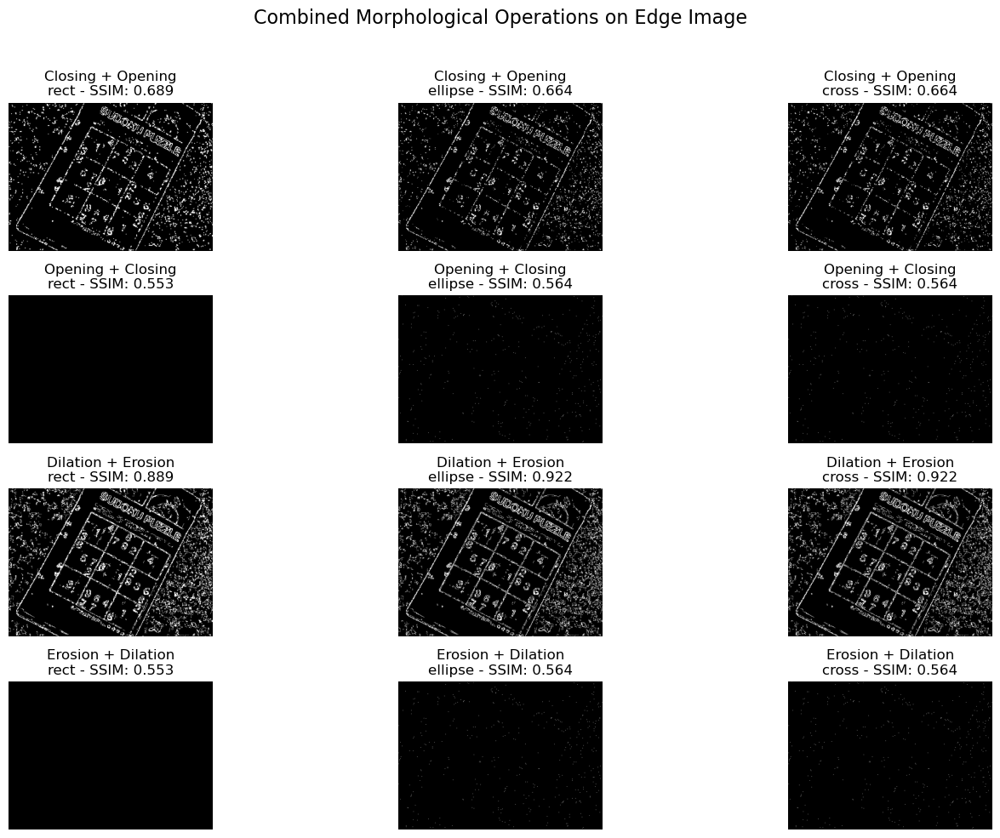

In [47]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim

def apply_morph_combo(edge_img, combo=["closing"], kernel_shape="rect", kernel_size=3):
    """Apply a sequence of morphological operations."""
    if kernel_shape == "rect":
        kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernel_size, kernel_size))
    elif kernel_shape == "ellipse":
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))
    elif kernel_shape == "cross":
        kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (kernel_size, kernel_size))
    else:
        raise ValueError("Invalid kernel shape")

    processed = edge_img.copy()
    for method in combo:
        if method == "closing":
            processed = cv2.morphologyEx(processed, cv2.MORPH_CLOSE, kernel)
        elif method == "opening":
            processed = cv2.morphologyEx(processed, cv2.MORPH_OPEN, kernel)
        elif method == "dilation":
            processed = cv2.dilate(processed, kernel, iterations=1)
        elif method == "erosion":
            processed = cv2.erode(processed, kernel, iterations=1)
        else:
            raise ValueError("Invalid method")

    return processed

# Load grayscale image and detect edges
img = cv2.imread("Images/Sudoku1.jpg", cv2.IMREAD_GRAYSCALE)
edges = cv2.Canny(img, 100, 200)

# Define combined methods
combinations = [
    ["closing", "opening"],
    ["opening", "closing"],
    ["dilation", "erosion"],
    ["erosion", "dilation"]
]
shapes = ["rect", "ellipse", "cross"]

fig, axs = plt.subplots(len(combinations), len(shapes), figsize=(15, 10))

for i, combo in enumerate(combinations):
    for j, shape in enumerate(shapes):
        processed = apply_morph_combo(edges, combo=combo, kernel_shape=shape)
        score = ssim(edges, processed, data_range=255)
        combo_name = " + ".join([m.capitalize() for m in combo])
        axs[i, j].imshow(processed, cmap='gray')
        axs[i, j].set_title(f"{combo_name}\n{shape} - SSIM: {score:.3f}")
        axs[i, j].axis('off')

plt.suptitle("Combined Morphological Operations on Edge Image", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


## 🧪 Morphological Operations: Combined Effects on Edge Map

This section evaluates how combining morphological operations (e.g., `closing + opening`, `dilation + erosion`) affects the quality of edge-detected images using different structuring element shapes.

### 🧩 Experimental Setup
- **Input Image:** Edge map generated from a grayscale Sudoku image using the Canny detector.
- **Morphological Combos Tested:**
  - `Closing + Opening`
  - `Opening + Closing`
  - `Dilation + Erosion`
  - `Erosion + Dilation`
- **Kernels Used:**
  - Rectangular
  - Elliptical
  - Cross-shaped
- **Evaluation Metric:** Structural Similarity Index (SSIM) with the original Canny output.

---

### 📊 Observations

| Combination | Kernel | SSIM | Visual Notes |
|-------------|--------|------|---------------|
| Closing + Opening | Rect | 0.689 | Balanced noise cleanup & contour preservation |
| Closing + Opening | Ellipse | 0.664 | Smooth but slightly weaker line recovery |
| Closing + Opening | Cross | 0.664 | Similar to ellipse, slight loss of sharpness |
| Opening + Closing | Rect | 0.553 | Over-filtered: edges mostly removed |
| Opening + Closing | Ellipse | 0.564 | Slightly better, but still highly eroded |
| Opening + Closing | Cross | 0.564 | Still leads to over-smoothing |
| Dilation + Erosion | Rect | 0.889 | Good noise removal + strong edge structure |
| Dilation + Erosion | Ellipse | 0.922 | Best SSIM; strong coherence and clarity |
| Dilation + Erosion | Cross | 0.922 | Excellent edge recovery, visually clear |
| Erosion + Dilation | Rect | 0.553 | Excessive suppression of fine structures |
| Erosion + Dilation | Ellipse | 0.564 | Slightly more forgiving but still destructive |
| Erosion + Dilation | Cross | 0.564 | Least favorable for this ordering |

---

### ✅ Insights

- **Best Combo:** `Dilation + Erosion` with `ellipse` or `cross` kernels gives the highest SSIM and clearest lines.
- **Worst Combo:** `Opening + Closing` and `Erosion + Dilation` over-suppress edge features, especially with rectangular kernels.
- **Kernel Effect:** Elliptical and cross-shaped kernels outperform rectangular ones in maintaining structural integrity in combined operations.
- **Use Case Suggestion:** For edge post-processing in structured images (like text or grids), prefer `Dilation + Erosion` with ellipse kernels.

---

### 💡 Conclusion

Sequential morphological filtering is highly sensitive to operation order and kernel type. Combining `dilation` followed by `erosion` helps preserve meaningful structure while reducing noise—optimal for document-like or pattern-rich images.


In [49]:
import nbformat

# Load both notebooks
with open("CVLab4Part2.ipynb") as f:
    nb2 = nbformat.read(f, as_version=4)

with open("../Lab4_PartI/CVLab4-Part1.ipynb") as f:
    nb1 = nbformat.read(f, as_version=4)

# Create new notebook with combined cells
merged = nbformat.v4.new_notebook()
merged.cells = nb1.cells + nb2.cells

# Save merged notebook
with open("mergedLab4..ipynb", "w") as f:
    nbformat.write(merged, f)


NameError: name 's' is not defined